**Steganography based Secure Messaging System (Image)**

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/stegoimagesdataset/dataset_information.csv
/kaggle/input/stegoimagesdataset/val/val/clean/06781.png
/kaggle/input/stegoimagesdataset/val/val/clean/07470.png
/kaggle/input/stegoimagesdataset/val/val/clean/07161.png
/kaggle/input/stegoimagesdataset/val/val/clean/06102.png
/kaggle/input/stegoimagesdataset/val/val/clean/07814.png
/kaggle/input/stegoimagesdataset/val/val/clean/06076.png
/kaggle/input/stegoimagesdataset/val/val/clean/06877.png
/kaggle/input/stegoimagesdataset/val/val/clean/06852.png
/kaggle/input/stegoimagesdataset/val/val/clean/07968.png
/kaggle/input/stegoimagesdataset/val/val/clean/07430.png
/kaggle/input/stegoimagesdataset/val/val/clean/07901.png
/kaggle/input/stegoimagesdataset/val/val/clean/06027.png
/kaggle/input/stegoimagesdataset/val/val/clean/06426.png
/kaggle/input/stegoimagesdataset/val/val/clean/07874.png
/kaggle/input/stegoimagesdataset/val/val/clean/06704.png
/kaggle/input/stegoimagesdataset/val/val/clean/07512.png
/kaggle/input/stegoimagesdatase

In [ ]:
import os
import kagglehub

# Download latest version of the dataset
dataset_path = kagglehub.dataset_download("marcozuppelli/stegoimagesdataset")

# Check if the dataset exists
if os.path.exists(dataset_path):
    print("Dataset loaded successfully!")
    print("Path to dataset files:", dataset_path)
    print("Files in dataset:", os.listdir(dataset_path))
else:
    print("Dataset not found. Make sure it has been downloaded correctly.")


Dataset loaded successfully!
Path to dataset files: /kaggle/input/stegoimagesdataset
Files in dataset: ['val', 'test', 'train', 'dataset_information.csv']


In [ ]:
import os
import kagglehub

# Download latest version of the dataset
dataset_path = kagglehub.dataset_download("valkling/star-wars-steganography-images")

# Check if the dataset exists
if os.path.exists(dataset_path):
    print("Dataset loaded successfully!")
    print("Path to dataset files:", dataset_path)
    print("Files in dataset:", os.listdir(dataset_path))
else:
    print("Dataset not found. Make sure it has been downloaded correctly.")


Dataset loaded successfully!
Path to dataset files: /kaggle/input/star-wars-steganography-images
Files in dataset: ['Empire_Strikes_Back _Trailer.mp4', 'R2D2.jpg', 'death_star_HD.jpg', 'Death-Star.jpg', 'x-wing.jpg', 'x-wing-HD.jpg', 'Phantom_Menace_Trailer.mp4', 'Deathstar_blueprint.jpg']


Total files in dataset: 8
Number of image files: 6
Sample files: ['R2D2.jpg', 'death_star_HD.jpg', 'Death-Star.jpg', 'x-wing.jpg', 'x-wing-HD.jpg']

Dataset Summary:
                  Filename  Width  Height Mode
0                 R2D2.jpg    550     775  RGB
1        death_star_HD.jpg   4096    2048  RGB
2           Death-Star.jpg    561     559  RGB
3               x-wing.jpg   2000    1068  RGB
4            x-wing-HD.jpg   3840    2160  RGB
5  Deathstar_blueprint.jpg    550     550    L


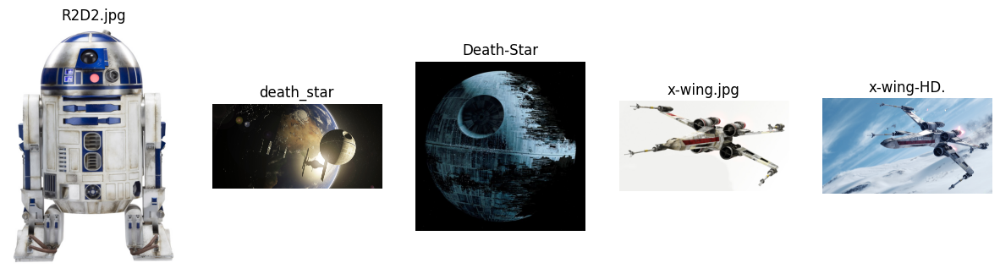

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

# Use the dataset path provided by kagglehub
dataset_path = kagglehub.dataset_download("valkling/star-wars-steganography-images")

# List all files in the dataset directory
all_files = os.listdir(dataset_path)

# Check for image files
image_extensions = {".jpg", ".jpeg", ".png", ".bmp", ".tiff"}
image_files = [f for f in all_files if os.path.splitext(f)[1].lower() in image_extensions]

# Display basic dataset information
print(f"Total files in dataset: {len(all_files)}")
print(f"Number of image files: {len(image_files)}")
print("Sample files:", image_files[:5])  # Show first 5 files

# Function to get image details
def analyze_images(image_files, dataset_path):
    image_data = []

    for img_file in image_files[:10]:  # Limit to first 10 images for speed
        img_path = os.path.join(dataset_path, img_file)
        image = Image.open(img_path)
        width, height = image.size
        mode = image.mode  # Color mode (RGB, Grayscale, etc.)

        image_data.append({"Filename": img_file, "Width": width, "Height": height, "Mode": mode})

    return pd.DataFrame(image_data)

# Create a DataFrame with image details
image_df = analyze_images(image_files, dataset_path)
print("\nDataset Summary:")
print(image_df)

# Display a few sample images
fig, axes = plt.subplots(1, 5, figsize=(15, 5))
for i, img_file in enumerate(image_files[:5]):
    img_path = os.path.join(dataset_path, img_file)
    image = Image.open(img_path)
    axes[i].imshow(image)
    axes[i].axis("off")
    axes[i].set_title(img_file[:10])

plt.show()


In [ ]:
import cv2
import numpy as np
import pywt
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


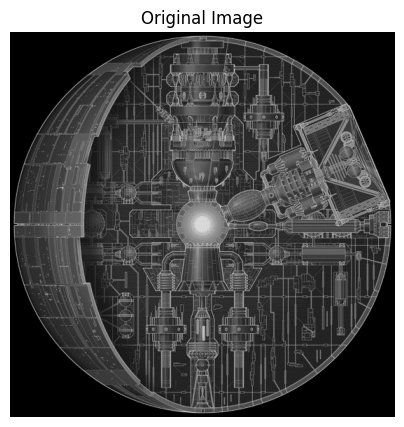

In [ ]:
def load_image(image_path):
    image = cv2.imread(image_path)  # Load image
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for correct display
    return image

# Load Image
image_path = "/kaggle/input/star-wars-steganography-images/Deathstar_blueprint.jpg"  # Change to your actual image path
original_image = load_image(image_path)

# Display Original Image
plt.figure(figsize=(5,5))
plt.imshow(original_image)
plt.title("Original Image")
plt.axis("off")
plt.show()


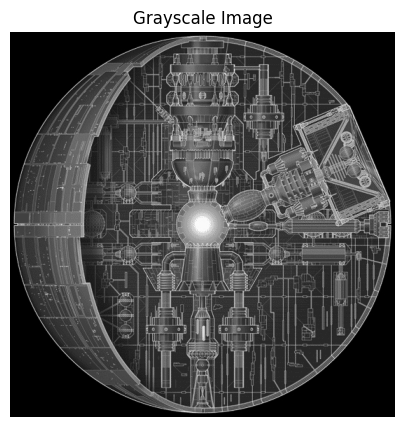

In [ ]:
def convert_to_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

gray_img = convert_to_grayscale(original_image)

plt.figure(figsize=(5,5))
plt.imshow(gray_img, cmap="gray")
plt.title("Grayscale Image")
plt.axis("off")
plt.show()


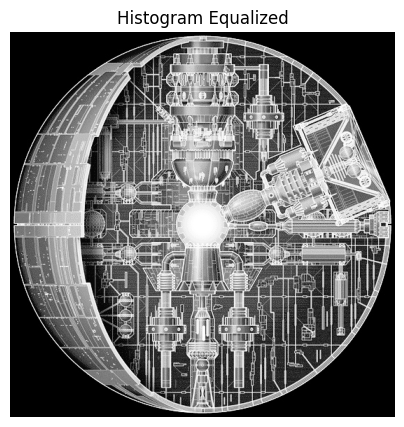

In [ ]:
def histogram_equalization(image):
    return cv2.equalizeHist(image)

hist_eq_img = histogram_equalization(gray_img)

plt.figure(figsize=(5,5))
plt.imshow(hist_eq_img, cmap="gray")
plt.title("Histogram Equalized")
plt.axis("off")
plt.show()


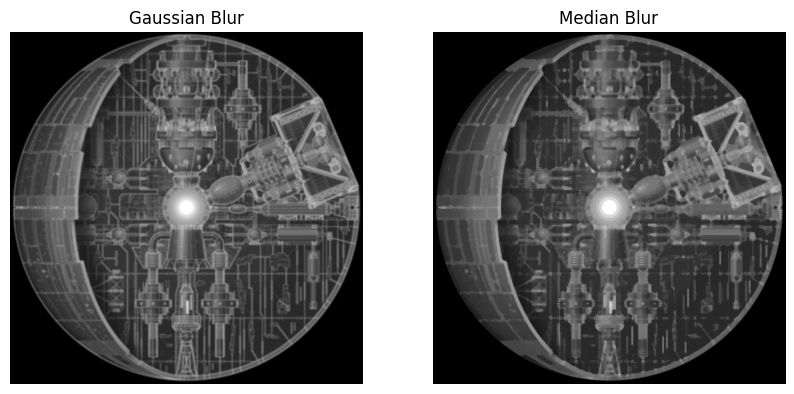

In [ ]:
def denoise_image(image):
    gaussian_blur = cv2.GaussianBlur(image, (5, 5), 0)
    median_blur = cv2.medianBlur(image, 5)
    return gaussian_blur, median_blur

gaussian_img, median_img = denoise_image(gray_img)

# Display Both Denoised Images
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

ax[0].imshow(gaussian_img, cmap="gray")
ax[0].set_title("Gaussian Blur")
ax[0].axis("off")

ax[1].imshow(median_img, cmap="gray")
ax[1].set_title("Median Blur")
ax[1].axis("off")

plt.show()


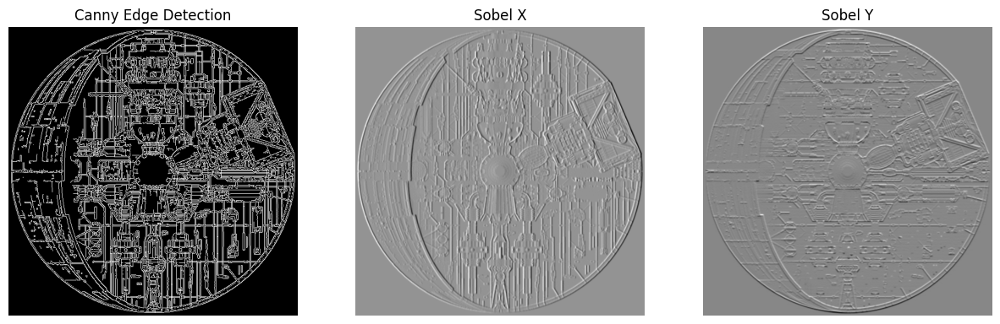

In [ ]:
def edge_detection(image):
    edges_canny = cv2.Canny(image, 100, 200)
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=5)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=5)
    return edges_canny, sobel_x, sobel_y

edges_canny, sobel_x, sobel_y = edge_detection(gray_img)

# Display Edge Detection Results
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

ax[0].imshow(edges_canny, cmap="gray")
ax[0].set_title("Canny Edge Detection")
ax[0].axis("off")

ax[1].imshow(sobel_x, cmap="gray")
ax[1].set_title("Sobel X")
ax[1].axis("off")

ax[2].imshow(sobel_y, cmap="gray")
ax[2].set_title("Sobel Y")
ax[2].axis("off")

plt.show()


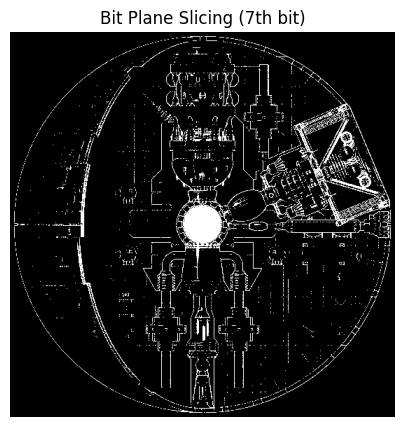

In [ ]:
def bit_plane_slicing(image, bit_plane):
    return (image & (1 << bit_plane)) >> bit_plane

bit_plane_7 = bit_plane_slicing(gray_img, 7)  # Extract 7th Bit Plane

plt.figure(figsize=(5,5))
plt.imshow(bit_plane_7 * 255, cmap="gray")
plt.title("Bit Plane Slicing (7th bit)")
plt.axis("off")
plt.show()


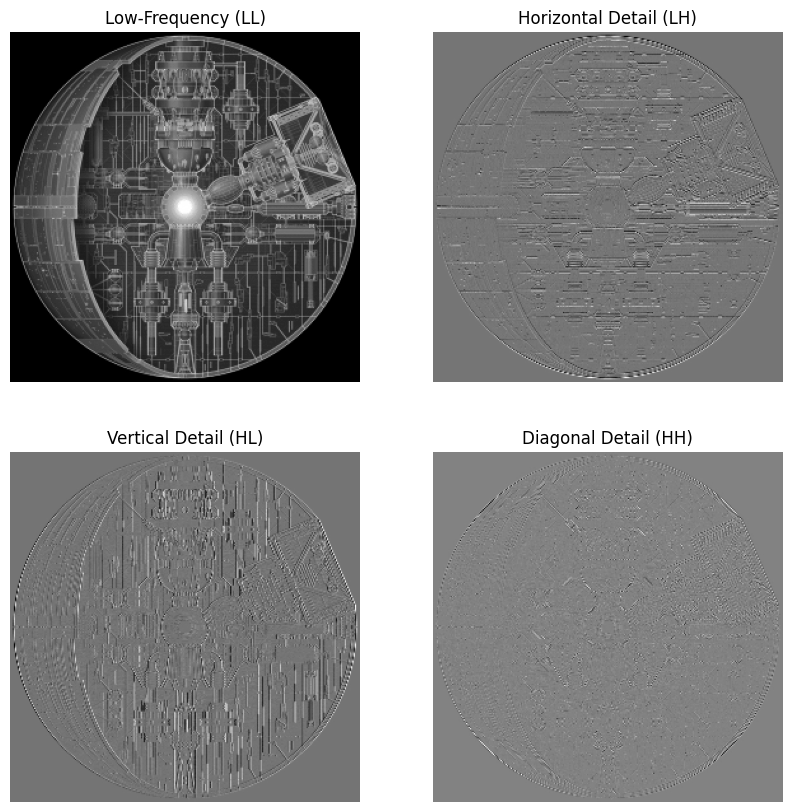

In [ ]:
def apply_dwt(image):
    coeffs2 = pywt.dwt2(image, 'haar')
    LL, (LH, HL, HH) = coeffs2  # Low and high-frequency components
    return LL, LH, HL, HH

LL, LH, HL, HH = apply_dwt(gray_img)

# Display DWT Results
fig, ax = plt.subplots(2, 2, figsize=(10, 10))

ax[0,0].imshow(LL, cmap="gray")
ax[0,0].set_title("Low-Frequency (LL)")
ax[0,0].axis("off")

ax[0,1].imshow(LH, cmap="gray")
ax[0,1].set_title("Horizontal Detail (LH)")
ax[0,1].axis("off")

ax[1,0].imshow(HL, cmap="gray")
ax[1,0].set_title("Vertical Detail (HL)")
ax[1,0].axis("off")

ax[1,1].imshow(HH, cmap="gray")
ax[1,1].set_title("Diagonal Detail (HH)")
ax[1,1].axis("off")

plt.show()


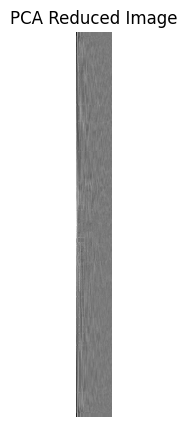

In [ ]:
def apply_pca(image):
    pca = PCA(n_components=50)  # Reduce to 50 components
    transformed = pca.fit_transform(image)
    return transformed

pca_img = apply_pca(gray_img)

plt.figure(figsize=(5,5))
plt.imshow(pca_img, cmap="gray")
plt.title("PCA Reduced Image")
plt.axis("off")
plt.show()


In [ ]:
from cryptography.fernet import Fernet
import base64
from Crypto.Cipher import AES
from Crypto.Util.Padding import pad
from Crypto.Random import get_random_bytes
import base64


In [ ]:
def generate_aes_key():
    key = get_random_bytes(32)  # Generate a 256-bit (32-byte) AES key
    with open("aes_secret.key", "wb") as key_file:
        key_file.write(key)  # Save key securely
    print("🔑 AES-256 key generated and saved as 'aes_secret.key'")
    return key

# Generate & save the key (run this once)
generate_aes_key()


🔑 AES-256 key generated and saved as 'aes_secret.key'


b'\xad\xff\x03fdq!\x9dt\xffYh\xa3q\xbddJ\xfb<\x13\x86N\x8fj\xfa\xd9z\\!=P\x86'

In [ ]:
def load_aes_key():
    try:
        return open("aes_secret.key", "rb").read()  # Read the key
    except FileNotFoundError:
        print("Error: AES secret key file not found! Generate the key first.")
        return None

# Load the previously saved AES key
aes_key = load_aes_key()
if aes_key:
    print("✅ AES key loaded successfully!")


✅ AES key loaded successfully!


In [ ]:
from Crypto.Cipher import AES
from Crypto.Util.Padding import pad
from Crypto.Random import get_random_bytes
import base64

def encrypt_message_aes(message, key):
    iv = get_random_bytes(16)  # Generate a random 16-byte IV
    cipher = AES.new(key, AES.MODE_CBC, iv)  # Initialize AES in CBC mode
    encrypted_bytes = cipher.encrypt(pad(message.encode(), AES.block_size))  # Encrypt the message
    encrypted_data = iv + encrypted_bytes  # Combine IV + Encrypted Data
    encoded_encrypted_text = base64.b64encode(encrypted_data).decode()  # Convert to Base64

    # Convert encrypted bytes to bits (binary)
    encrypted_bits = ''.join(format(byte, '08b') for byte in encrypted_bytes)

    # Convert encrypted bytes to hexadecimal
    encrypted_hex = encrypted_bytes.hex()

    # **Proof of Encryption - Displaying Outputs**
    print("🔹 Original Message:", message)
    print("🔹 Encrypted Bytes (Raw Data):", encrypted_bytes)  # Random unreadable characters
    print("🔹 Encrypted Bits (Binary):", encrypted_bits)  # Binary representation
    print("🔹 Encrypted Hexadecimal:", encrypted_hex)  # Hexadecimal representation
    print("🔹 Encrypted Message (Base64):", encoded_encrypted_text)  # For embedding

    return encoded_encrypted_text

# Example Usage
message = "Hi this is team rudhra"
aes_key = get_random_bytes(32)  # Generate a 32-byte AES key (Temporary for Testing)

encrypted_text_aes = encrypt_message_aes(message, aes_key)


🔹 Original Message: Hi this is team rudhra
🔹 Encrypted Bytes (Raw Data): b'\x86~\x82tl[\xec\xe6\xcc\x13B\x825\xd0\xe6{\x12\xb1\xbb\x0cL\xb0\xfd<\xcf\x8f\xd6\xd3\xd7\xc2&\xd1'
🔹 Encrypted Bits (Binary): 1000011001111110100000100111010001101100010110111110110011100110110011000001001101000010100000100011010111010000111001100111101100010010101100011011101100001100010011001011000011111101001111001100111110001111110101101101001111010111110000100010011011010001
🔹 Encrypted Hexadecimal: 867e82746c5bece6cc13428235d0e67b12b1bb0c4cb0fd3ccf8fd6d3d7c226d1
🔹 Encrypted Message (Base64): R8Mdd8hFA47Dhx/7oFuUe4Z+gnRsW+zmzBNCgjXQ5nsSsbsMTLD9PM+P1tPXwibR


In [ ]:
import cv2
import numpy as np
from Crypto.Cipher import AES
from Crypto.Util.Padding import pad
from Crypto.Random import get_random_bytes
import base64


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from Crypto.Cipher import AES
from Crypto.Util.Padding import pad
from Crypto.Random import get_random_bytes


🔹 Original Message: This is a confidential message for steganography.
🔹 Encrypted Bytes (Raw Data): b'0\x9b!#\x13{\xc2\xfb\xef\xc2\x94b\xf7\x9a/\xcaA\xba\x8c\xf5f\xf1\x1c\x1eU0\xe5\xb5\x0f+\x8b\xb15\xf5\xfb\x10v\xb6\x16\x95\xb1\xd9\x16v\xe4\xca\xd1\xcf\xed\xff\x88~O\xdd\x088\x1f\x82B\x83\xae0\x89:'
🔹 Encrypted Message (Hexadecimal): 309a066b6938ff96f21f940f134c02fe309b2123137bc2fbefc29462f79a2fca41ba8cf566f11c1e5530e5b50f2b8bb135f5fb1076b61695b1d91676e4cad1cfedff887e4fdd08381f824283ae30893a

✅ Encrypted message hidden in image successfully!


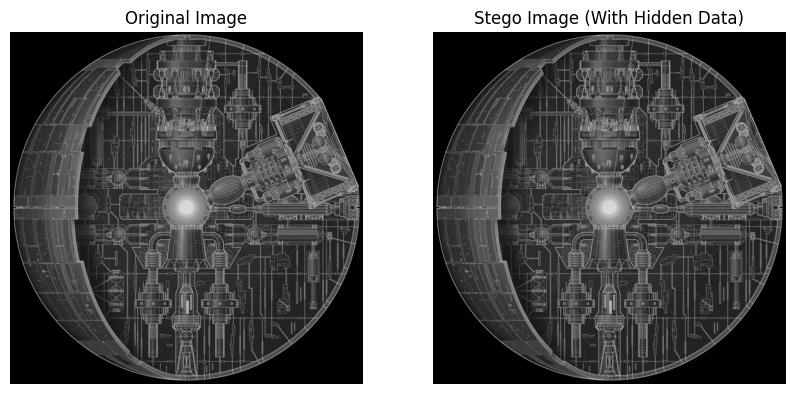


📌 Evaluation Metrics:
🔹 PSNR: 82.37 dB
🔹 SSIM: 1.0000
🔹 BPP (Payload Capacity): 0.000705


In [ ]:
# 🔹 Encryption Function (AES + Hexadecimal)
def encrypt_message_aes(message, key):
    iv = get_random_bytes(16)  # Generate a 16-byte IV
    cipher = AES.new(key, AES.MODE_CBC, iv)  # Initialize AES in CBC mode
    encrypted_bytes = cipher.encrypt(pad(message.encode(), AES.block_size))  # Encrypt message
    encrypted_data = iv + encrypted_bytes  # IV + Encrypted Data
    hex_encrypted_text = encrypted_data.hex()  # Convert to Hexadecimal

    print("\n🔹 Original Message:", message)
    print("🔹 Encrypted Bytes (Raw Data):", encrypted_bytes)
    print("🔹 Encrypted Message (Hexadecimal):", hex_encrypted_text)  # Hex format for embedding

    return hex_encrypted_text

# 🔹 Function to Hide Data in an Image (Steganography)
def hide_text_in_image(image_path, secret_text, output_image_path):
    image = cv2.imread(image_path)  # Read the image
    if image is None:
        print("Error: Unable to read image!")
        return None

    # Convert text into binary format
    binary_text = ''.join(format(int(secret_text[i:i+2], 16), '08b') for i in range(0, len(secret_text), 2))
    binary_text += '1111111111111110'  # Delimiter to indicate end of the text

    data_index = 0
    text_length = len(binary_text)
    rows, cols, channels = image.shape  # Get image dimensions

    for row in range(rows):
        for col in range(cols):
            for channel in range(channels):  # Modify each RGB channel
                if data_index < text_length:
                    pixel_value = image[row, col, channel]
                    pixel_value = pixel_value & 0b11111110 | int(binary_text[data_index])  # Modify LSB
                    image[row, col, channel] = pixel_value
                    data_index += 1

    # Save the image with hidden text
    cv2.imwrite(output_image_path, image)
    print("\n✅ Encrypted message hidden in image successfully!")
    return image  # Return stego image

# 🔹 Function to Calculate Evaluation Metrics
def evaluate_steganography(original_image, stego_image, message_length):
    original = cv2.imread(original_image)
    stego = cv2.imread(stego_image)

    # Convert to grayscale for SSIM calculation
    original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
    stego_gray = cv2.cvtColor(stego, cv2.COLOR_BGR2GRAY)

    # Calculate PSNR
    psnr_value = psnr(original, stego)

    # Calculate SSIM
    ssim_value, _ = ssim(original_gray, stego_gray, full=True)

    # Calculate BPP (Bits Per Pixel)
    total_pixels = original.shape[0] * original.shape[1] * original.shape[2]
    bpp = message_length / total_pixels

    print(f"\n📌 Evaluation Metrics:")
    print(f"🔹 PSNR: {psnr_value:.2f} dB")
    print(f"🔹 SSIM: {ssim_value:.4f}")
    print(f"🔹 BPP (Payload Capacity): {bpp:.6f}")

# 🔹 Function to Display Original and Stego Images
def display_images(original_path, stego_path):
    original = cv2.imread(original_path)
    stego = cv2.imread(stego_path)

    # Convert images to RGB for Matplotlib display
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
    stego_rgb = cv2.cvtColor(stego, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 5))

    # Show original image
    plt.subplot(1, 2, 1)
    plt.imshow(original_rgb)
    plt.title("Original Image")
    plt.axis("off")

    # Show stego image
    plt.subplot(1, 2, 2)
    plt.imshow(stego_rgb)
    plt.title("Stego Image (With Hidden Data)")
    plt.axis("off")

    plt.show()

# 🔹 Example Usage (Using Your Image Path)
if __name__ == "__main__":
    # Define the message & encrypt it
    secret_message = "This is a confidential message for steganography."
    aes_key = get_random_bytes(32)  # Generate a 32-byte AES key
    encrypted_text = encrypt_message_aes(secret_message, aes_key)  # Encrypt the message

    # Use the provided image for steganography
    input_image_path = "/kaggle/input/star-wars-steganography-images/Deathstar_blueprint.jpg"  # Your image
    output_image_path = "/kaggle/working/stego_image.png"  # Image with hidden data

    stego_image = hide_text_in_image(input_image_path, encrypted_text, output_image_path)

    if stego_image is not None:
        # Display the original and stego images side by side
        display_images(input_image_path, output_image_path)

        # Evaluate steganography quality
        evaluate_steganography(input_image_path, output_image_path, len(encrypted_text) * 4)


In [ ]:
!pip install pycryptodome opencv-python numpy scikit-image matplotlib torch torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 39.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 108.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 72.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 45.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 98.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [ ]:
pip install -U scikit-image



🔹 Original Message: This is chiranjeevi from AIE-A with roll number two thousand two hundres thirty six in amrita vishwa vidyapeetham.i know that i am a student and my roommates are cadva, saleem bhai and savata dinesh.
🔹 Encryption Key (Hex): e27f3732cbff50a31a518c33d82e917acd69fc23560d0a78f7b653bc9f3286e7
🔹 Encrypted Message (Hexadecimal): 9bb751a8cfabb3c9930cee667f2efa59400ebf885fdaa7bc43b9216f166ce89638adbdb7f5a418350aec1a24f3a1f714425b3a25ec6b62f582af599d0330de8c0c6af2b7a80ba50143455d4dc0337d545fbe0d99e6ac40ce80e68e2b9e9503888864ae3da784c99eaf4613521e91495410cfc6388eb870a003944c26e0103bdaca93adaa50a534db62920b10972d0a6c2f87cf4340d9db5f113cd0641311952da00e02040095d3c8c5c8cb9b2a30b9a56c899686fec5bd271512af8bef969cc427c11a7516c83b599db1023fe3b479fd92c64adddb65780e1be0b8def111d47d

✅ Stego image saved successfully at /content/stego.png


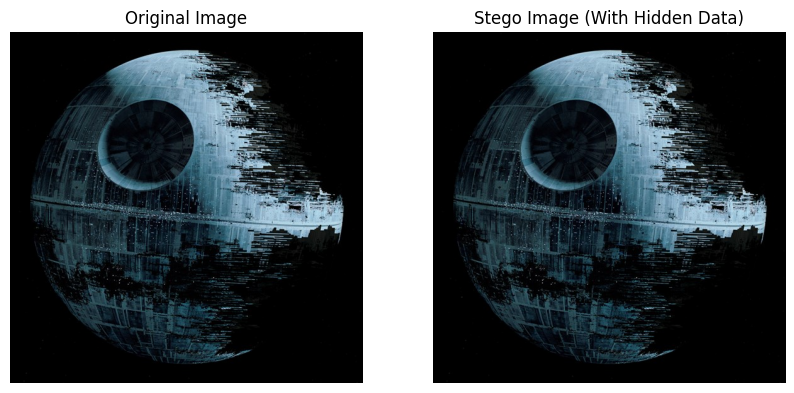


📌 Evaluation Metrics:
🔹 PSNR: 78.40 dB
🔹 SSIM: 1.0000
🔹 BPP (Payload Capacity): 0.001905


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes
from Crypto.Util.Padding import pad
from skimage.metrics import structural_similarity as ssim

def psnr(original, stego):
    mse = np.mean((original - stego) ** 2)
    if mse == 0:
        return float('inf')
    max_pixel = 255.0
    return 20 * np.log10(max_pixel / np.sqrt(mse))

# 🔹 Encryption Function (AES + Hexadecimal)
def encrypt_message_aes(message, key):
    iv = get_random_bytes(16)  # Generate a 16-byte IV
    cipher = AES.new(key, AES.MODE_CBC, iv)  # Initialize AES in CBC mode
    encrypted_bytes = cipher.encrypt(pad(message.encode(), AES.block_size))  # Encrypt message
    encrypted_data = iv + encrypted_bytes  # IV + Encrypted Data
    hex_encrypted_text = encrypted_data.hex()  # Convert to Hexadecimal

    print("\n🔹 Original Message:", message)
    print("🔹 Encryption Key (Hex):", key.hex())  # Print the key in hexadecimal format
    print("🔹 Encrypted Message (Hexadecimal):", hex_encrypted_text)  # Hex format for embedding

    return hex_encrypted_text

# 🔹 Function to Hide Data in an Image (Steganography)
def hide_text_in_image(image_path, secret_text, output_image_path):
    image = cv2.imread(image_path)  # Read the image
    if image is None:
        print("Error: Unable to read image!")
        return None

    # Convert text into binary format
    binary_text = ''.join(format(int(secret_text[i:i+2], 16), '08b') for i in range(0, len(secret_text), 2))
    binary_text += '1111111111111110'  # Delimiter to indicate end of the text

    data_index = 0
    text_length = len(binary_text)
    rows, cols, channels = image.shape  # Get image dimensions

    for row in range(rows):
        for col in range(cols):
            for channel in range(channels):  # Modify each RGB channel
                if data_index < text_length:
                    pixel_value = image[row, col, channel]
                    pixel_value = pixel_value & 0b11111110 | int(binary_text[data_index])  # Modify LSB
                    image[row, col, channel] = pixel_value
                    data_index += 1

    # Save the image with hidden text
    if cv2.imwrite(output_image_path, image):
        print(f"\n✅ Stego image saved successfully at {output_image_path}")
    else:
        print("❌ Error: Failed to save stego image!")

    return image  # Return stego image

# 🔹 Function to Calculate Evaluation Metrics
def evaluate_steganography(original_image, stego_image, message_length):
    original = cv2.imread(original_image)
    stego = cv2.imread(stego_image)

    # Convert to grayscale for SSIM calculation
    original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
    stego_gray = cv2.cvtColor(stego, cv2.COLOR_BGR2GRAY)

    # Calculate PSNR
    psnr_value = psnr(original, stego)

    # Calculate SSIM
    ssim_value, _ = ssim(original_gray, stego_gray, full=True)

    # Calculate BPP (Bits Per Pixel)
    total_pixels = original.shape[0] * original.shape[1] * original.shape[2]
    bpp = message_length / total_pixels

    print(f"\n📌 Evaluation Metrics:")
    print(f"🔹 PSNR: {psnr_value:.2f} dB")
    print(f"🔹 SSIM: {ssim_value:.4f}")
    print(f"🔹 BPP (Payload Capacity): {bpp:.6f}")

# 🔹 Function to Display Original and Stego Images
def display_images(original_path, stego_path):
    original = cv2.imread(original_path)
    stego = cv2.imread(stego_path)

    # Convert images to RGB for Matplotlib display
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
    stego_rgb = cv2.cvtColor(stego, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 5))

    # Show original image
    plt.subplot(1, 2, 1)
    plt.imshow(original_rgb)
    plt.title("Original Image")
    plt.axis("off")

    # Show stego image
    plt.subplot(1, 2, 2)
    plt.imshow(stego_rgb)
    plt.title("Stego Image (With Hidden Data)")
    plt.axis("off")

    plt.show()

# 🔹 Example Usage (Using Your Image Path)
if __name__ == "__main__":
    # Define the message & encrypt it
    secret_message = "This is chiranjeevi from AIE-A with roll number two thousand two hundres thirty six in amrita vishwa vidyapeetham.i know that i am a student and my roommates are cadva, saleem bhai and savata dinesh."

    # Use a predefined key for encryption
    aes_key = get_random_bytes(32)  # Generate a 32-byte AES key
    encrypted_text = encrypt_message_aes(secret_message, aes_key)  # Encrypt the message

    # Use the provided image for steganography
    input_image_path = "/content/Death-Star.jpg"  # Your image
    output_image_path = "/content/stego.png"  # Image with hidden data

    stego_image = hide_text_in_image(input_image_path, encrypted_text, output_image_path)

    if stego_image is not None:
        # Display the original and stego images side by side
        display_images(input_image_path, output_image_path)

        # Evaluate steganography quality
        evaluate_steganography(input_image_path, output_image_path, len(encrypted_text) * 4)

In [ ]:
import os
print("Original Image Size:", os.path.getsize(input_image_path), "bytes")
print("Stego Image Size:", os.path.getsize(output_image_path), "bytes")


Original Image Size: 73611 bytes
Stego Image Size: 406916 bytes


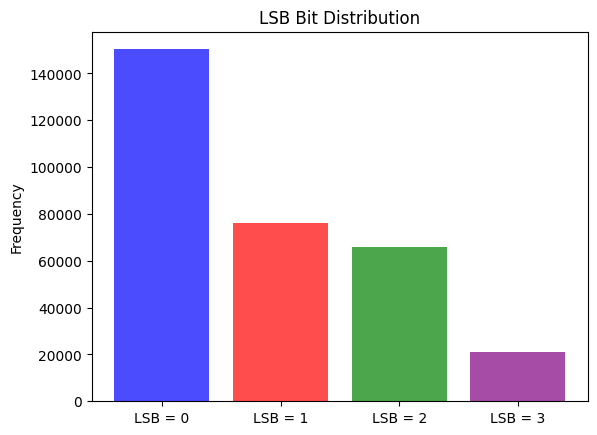

✅ Stego Image Detected! (Entropy: 1.7403)


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import entropy

# 🔹 Load Image
def load_image(image_path):
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError("Image not found. Check the file path.")
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# 🔹 Extract LSBs from All RGB Channels
def extract_lsb(image):
    red_channel = image[:, :, 0]  # Extract Red channel
    green_channel = image[:, :, 1]  # Extract Green channel
    blue_channel = image[:, :, 2]  # Extract Blue channel

    # Combine LSBs of all channels
    lsb_matrix = (red_channel & 1) + (green_channel & 1) + (blue_channel & 1)
    return lsb_matrix.flatten()

# 🔹 Detect Hidden Data Using Global Entropy
def detect_steganography(image_path):
    # Load image
    image = load_image(image_path)

    # Extract LSBs
    lsb_bits = extract_lsb(image)

    # Compute Histogram of LSBs (To check randomness)
    lsb_hist = np.bincount(lsb_bits, minlength=4)
    prob_dist = lsb_hist / np.sum(lsb_hist)
    lsb_entropy = entropy(prob_dist, base=2)  # Shannon Entropy

    # Show Histogram
    plt.bar(range(len(lsb_hist)), lsb_hist, color=['blue', 'red', 'green', 'purple'], alpha=0.7)
    plt.xticks(range(len(lsb_hist)), [f"LSB = {i}" for i in range(len(lsb_hist))])
    plt.ylabel("Frequency")
    plt.title("LSB Bit Distribution")
    plt.show()

    # Threshold-Based Detection
    if lsb_entropy > 0.95:  # Adjusted threshold for better detection
        print(f"✅ Stego Image Detected! (Entropy: {lsb_entropy:.4f})")
        return True
    else:
        print(f"❌ No Hidden Data Found. (Entropy: {lsb_entropy:.4f})")
        return False

# 🔹 Local Entropy Analysis for Hidden Data Regions
def detect_local_entropy(image_path, block_size=32):
    image = load_image(image_path)
    h, w, _ = image.shape

    # Divide into blocks and analyze entropy
    for i in range(0, h, block_size):
        for j in range(0, w, block_size):
            block = image[i:i+block_size, j:j+block_size, :]
            lsb_block = extract_lsb(block)
            lsb_hist = np.bincount(lsb_block, minlength=4)
            prob_dist = lsb_hist / np.sum(lsb_hist)
            local_entropy = entropy(prob_dist, base=2)

            # If entropy suggests hidden data, print region
            if local_entropy > 0.95:
                print(f"✅ Possible stego detected in region ({i}, {j}) with entropy: {local_entropy:.4f}")
                return True

    print("❌ No significant hidden data detected in any local region.")
    return False

# 🔹 Example Usage
stego_image_path = "/content/stego.png"  # Replace with your stego image path
contains_data = detect_steganography(stego_image_path)  # Global entropy check

# If global detection fails, try local entropy analysis
if not contains_data:
    detect_local_entropy(stego_image_path, block_size=32)


In [ ]:
!pip install opencv-python numpy tensorflow scikit-image matplotlib

Extracting the text from the Stego Image


✅ Extracted Encrypted Hexadecimal Value: 9bb751a8cfabb3c9930cee667f2efa59400ebf885fdaa7bc43b9216f166ce89638adbdb7f5a418350aec1a24f3a1f714425b3a25ec6b62f582af599d0330de8c0c6af2b7a80ba50143455d4dc0337d545fbe0d99e6ac40ce80e68e2b9e9503888864ae3da784c99eaf4613521e91495410cfc6388eb870a003944c26e0103bdaca93adaa50a534db62920b10972d0a6c2f87cf4340d9db5f113cd0641311952da00e02040095d3c8c5c8cb9b2a30b9a56c899686fec5bd271512af8bef969cc427c11a7516c83b599db1023fe3b479fd92c64adddb65780e1be0b8def111d47d

📌 Evaluation Metrics:
🔹 PSNR: 78.40 dB
🔹 SSIM: 1.0000


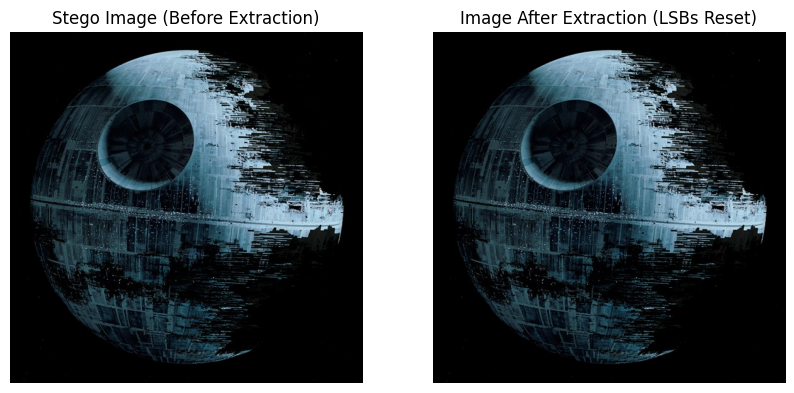

In [ ]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt

# 🔹 Function to Calculate PSNR
def psnr(original, stego):
    mse = np.mean((original - stego) ** 2)
    if mse == 0:
        return float('inf')
    max_pixel = 255.0
    return 20 * np.log10(max_pixel / np.sqrt(mse))

# 🔹 Function to Extract Hidden Data from an Image (LSB Steganography)
def extract_text_from_image(stego_image_path, original_image_path):
    # Load the stego image
    stego_image = cv2.imread(stego_image_path)
    if stego_image is None:
        raise ValueError("Error: Unable to read stego image!")

    # Load the original image for metrics calculation
    original_image = cv2.imread(original_image_path)
    if original_image is None:
        raise ValueError("Error: Unable to read original image!")

    rows, cols, channels = stego_image.shape  # Get image dimensions
    binary_text = ""  # To store the extracted binary data

    # Create a copy of the stego image to reset LSBs after extraction
    extracted_image = np.copy(stego_image)

    # Extract LSBs from each pixel
    for row in range(rows):
        for col in range(cols):
            for channel in range(channels):  # Check all RGB channels
                pixel_value = stego_image[row, col, channel]
                binary_text += str(pixel_value & 1)  # Extract LSB
                extracted_image[row, col, channel] = pixel_value & 0b11111110  # Reset LSB to 0

    # Find the delimiter to identify the end of the hidden message
    delimiter = '1111111111111110'
    end_index = binary_text.find(delimiter)

    # Check if delimiter is found, otherwise return empty string
    if end_index == -1:
        print("Delimiter not found in the image. The stego image may not contain a valid message.")
        return ""

    # Truncate the binary text at the delimiter
    binary_text = binary_text[:end_index]

    # Convert binary text to hexadecimal
    extracted_hex = ""
    for i in range(0, len(binary_text), 8):
        byte = binary_text[i:i+8]  # Split binary text into 8-bit chunks
        if len(byte) < 8:
            break  # Stop if the last byte is incomplete
        extracted_hex += format(int(byte, 2), '02x')  # Convert to hexadecimal

    print("\n✅ Extracted Encrypted Hexadecimal Value:", extracted_hex)

    # Calculate PSNR and SSIM
    psnr_value = psnr(original_image, stego_image)
    ssim_value, _ = ssim(cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY),
                         cv2.cvtColor(stego_image, cv2.COLOR_BGR2GRAY),
                         full=True)

    print(f"\n📌 Evaluation Metrics:")
    print(f"🔹 PSNR: {psnr_value:.2f} dB")
    print(f"🔹 SSIM: {ssim_value:.4f}")

    # Display the stego image and the image after extraction
    stego_rgb = cv2.cvtColor(stego_image, cv2.COLOR_BGR2RGB)
    extracted_rgb = cv2.cvtColor(extracted_image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 5))

    # Show stego image
    plt.subplot(1, 2, 1)
    plt.imshow(stego_rgb)
    plt.title("Stego Image (Before Extraction)")
    plt.axis("off")

    # Show extracted image (LSBs reset)
    plt.subplot(1, 2, 2)
    plt.imshow(extracted_rgb)
    plt.title("Image After Extraction (LSBs Reset)")
    plt.axis("off")

    plt.show()

    return extracted_hex

# 🔹 Example Usage
if __name__ == "__main__":
    # Path to the stego image and original image
    stego_image_path = "/content/stego.png"  # Replace with your stego image path
    original_image_path = "/content/Death-Star.jpg"  # Replace with your original image path

    # Step 1: Extract the encrypted hexadecimal message from the stego image
    extracted_hex = extract_text_from_image(stego_image_path, original_image_path)

Decryption using AES and Key

In [ ]:
from Crypto.Cipher import AES
from Crypto.Util.Padding import unpad

# 🔹 Function to Decrypt the Extracted Hexadecimal Message
def decrypt_message_aes(encrypted_hex, key):
    try:
        # If the key is provided as a hexadecimal string, convert it to bytes
        if isinstance(key, str):
            key = bytes.fromhex(key)  # Convert hex string to bytes

        # Check if the key length is valid for AES
        if len(key) not in [16, 24, 32]:
            print(f"Error: Invalid AES key length. Key must be 16, 24, or 32 bytes long. Provided key is {len(key)} bytes.")
            return ""

        # Convert hexadecimal to bytes
        encrypted_data = bytes.fromhex(encrypted_hex)

        # Check if the data length is sufficient for IV + encrypted message
        if len(encrypted_data) < 16:
            print("Error: Encrypted data is too short. It must contain at least 16 bytes for the IV.")
            return ""

        # Extract the IV (first 16 bytes) and the encrypted message
        iv = encrypted_data[:16]  # First 16 bytes are the IV
        encrypted_message = encrypted_data[16:]  # Remaining bytes are the encrypted message

        # Initialize AES cipher in CBC mode
        cipher = AES.new(key, AES.MODE_CBC, iv)

        # Decrypt the message
        decrypted_message = unpad(cipher.decrypt(encrypted_message), AES.block_size).decode()
        print("\n✅ Decrypted Original Message:", decrypted_message)
        return decrypted_message
    except ValueError as e:
        print(f"Error during decryption: {e}")
        print("Possible causes:")
        print("- The AES key is incorrect.")
        print("- The extracted hexadecimal value is incomplete or corrupted.")
        print("- The padding of the encrypted message is invalid.")
        return ""
    except Exception as e:
        print(f"Unexpected error: {e}")
        return ""

# 🔹 Example Usage
if __name__ == "__main__":
    # Provide the AES key and hexadecimal value directly
    aes_key = "e27f3732cbff50a31a518c33d82e917acd69fc23560d0a78f7b653bc9f3286e7"  # Replace with your 64-byte hexadecimal key
    encrypted_hex = "9bb751a8cfabb3c9930cee667f2efa59400ebf885fdaa7bc43b9216f166ce89638adbdb7f5a418350aec1a24f3a1f714425b3a25ec6b62f582af599d0330de8c0c6af2b7a80ba50143455d4dc0337d545fbe0d99e6ac40ce80e68e2b9e9503888864ae3da784c99eaf4613521e91495410cfc6388eb870a003944c26e0103bdaca93adaa50a534db62920b10972d0a6c2f87cf4340d9db5f113cd0641311952da00e02040095d3c8c5c8cb9b2a30b9a56c899686fec5bd271512af8bef969cc427c11a7516c83b599db1023fe3b479fd92c64adddb65780e1be0b8def111d47d"  # Replace with your hexadecimal value

    # Decrypt the provided hexadecimal message to get the original text
    original_text = decrypt_message_aes(encrypted_hex, aes_key)


✅ Decrypted Original Message: This is chiranjeevi from AIE-A with roll number two thousand two hundres thirty six in amrita vishwa vidyapeetham.i know that i am a student and my roommates are cadva, saleem bhai and savata dinesh.


Video Steganography based Message Passing System

Processing original frames...


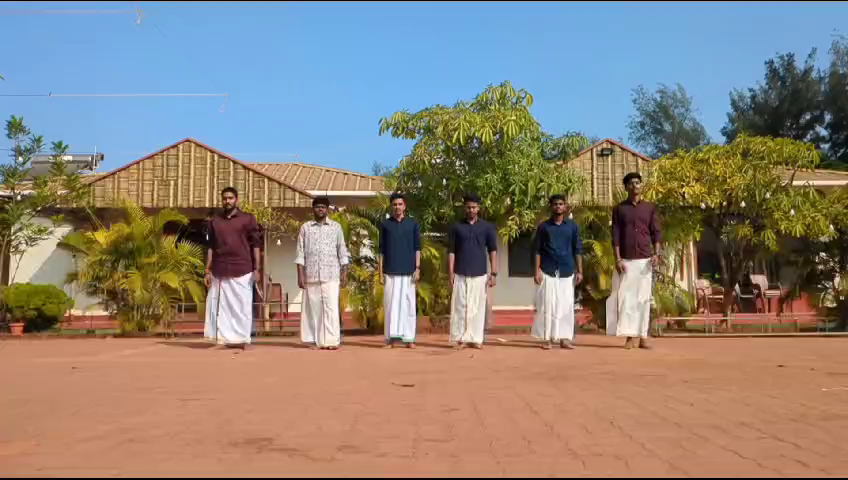

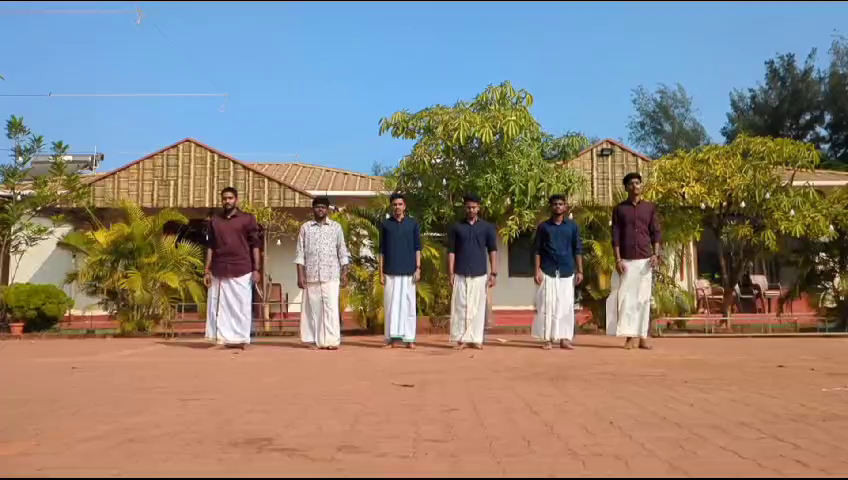

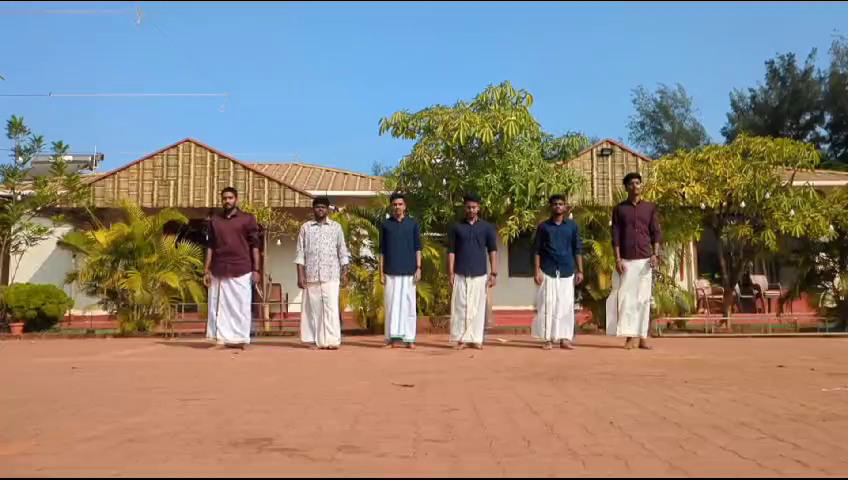

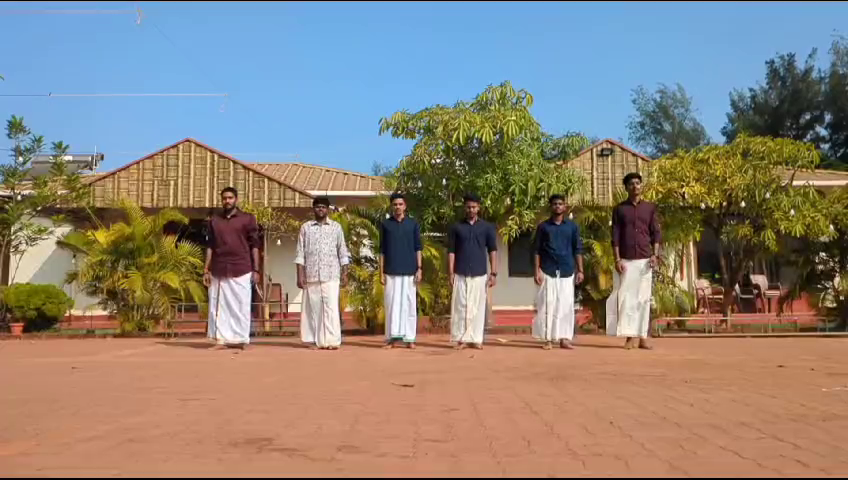

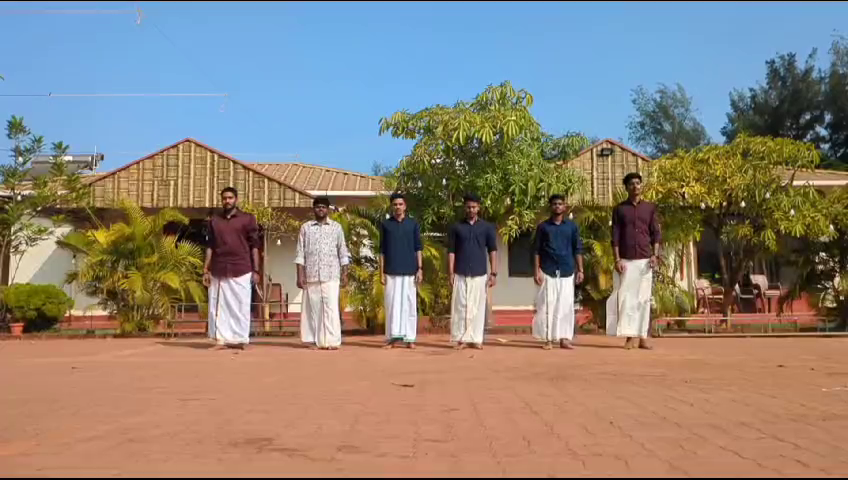

Step 1: Original frames displayed.


In [1]:
import cv2
import os
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Define video path
video_path = "/content/videostg.mp4"
output_dir = "preprocessed_frames"

# Check if file exists before opening
if not os.path.exists(video_path):
    print(f"Error: Video file '{video_path}' not found!")
    exit()

# Open the video file
cap = cv2.VideoCapture(video_path)

# Check if video is opened successfully
if not cap.isOpened():
    print("Error: Could not open video file.")
    exit()
else:
    print("Processing original frames...")

frame_count = 0

while frame_count < 5:  # Show only first 5 frames
    ret, frame = cap.read()
    if not ret:
        break

    cv2_imshow(frame)  # Display original frame
    frame_count += 1

cap.release()
print("Step 1: Original frames displayed.")


Pre-Processing

GrayScaling

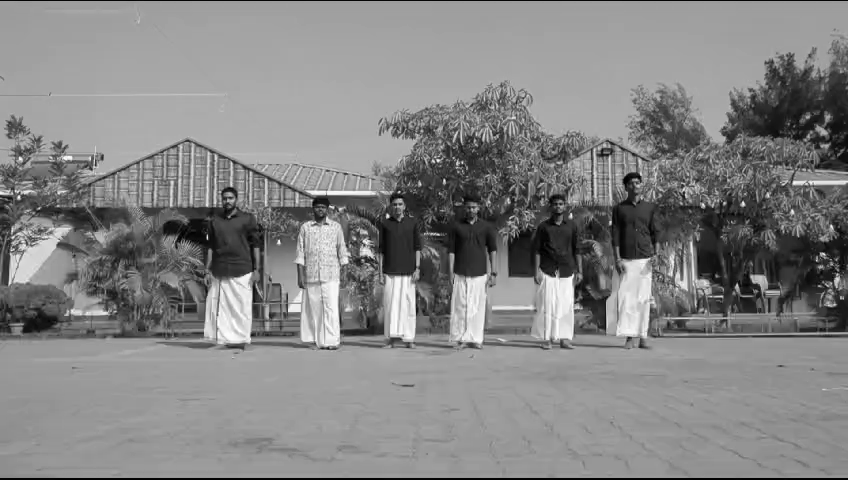

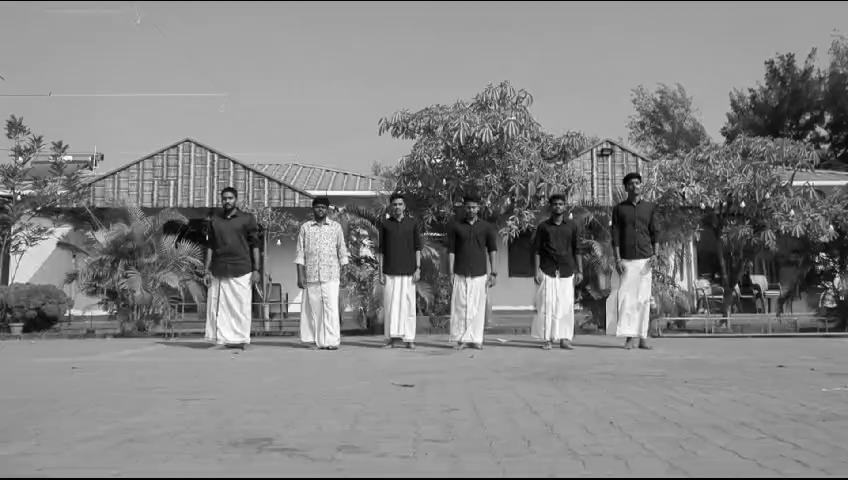

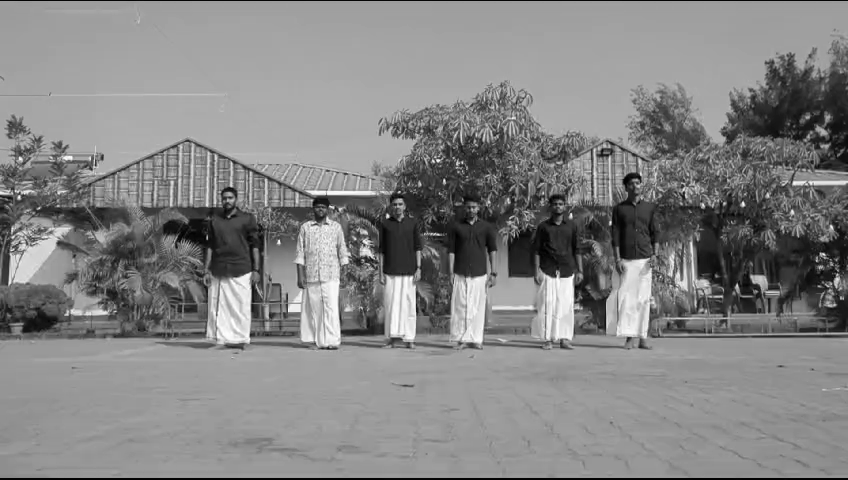

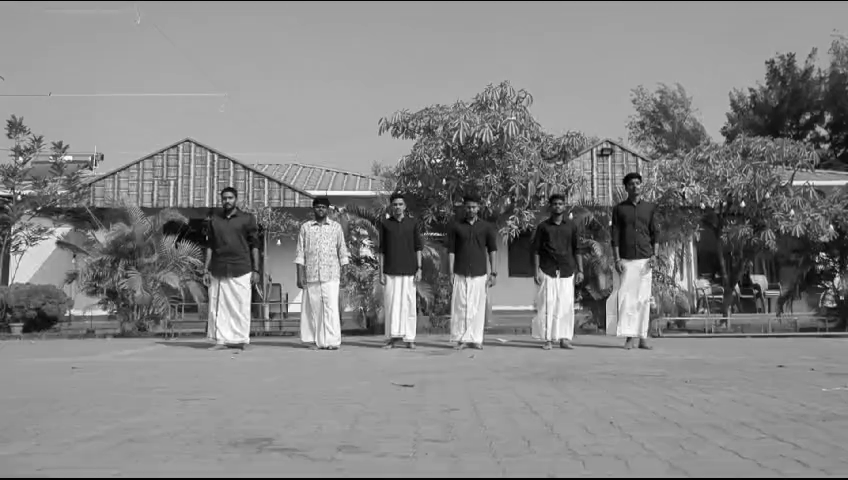

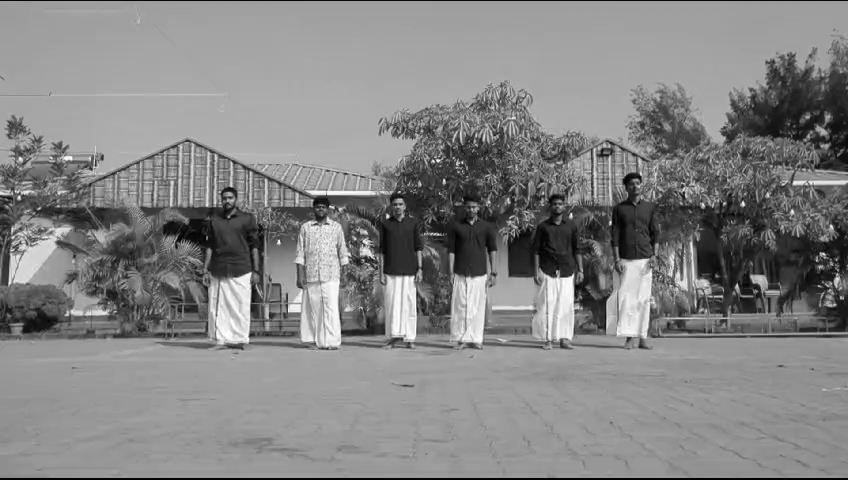

Step 2: Grayscale frames displayed.


In [2]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    cv2_imshow(gray_frame)  # Display grayscale frame
    frame_count += 1

cap.release()
print("Step 2: Grayscale frames displayed.")


Resizing

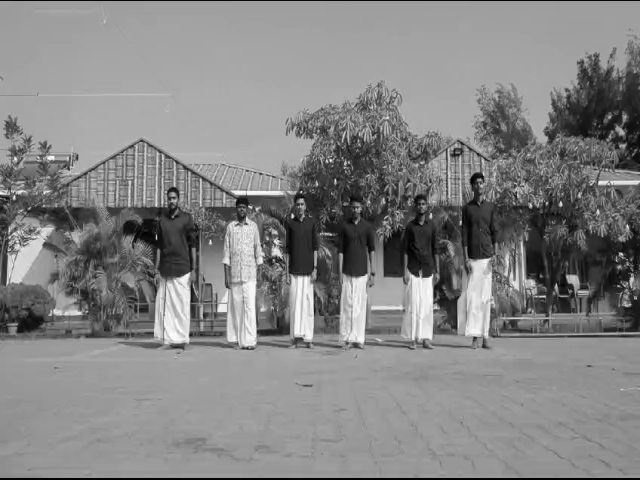

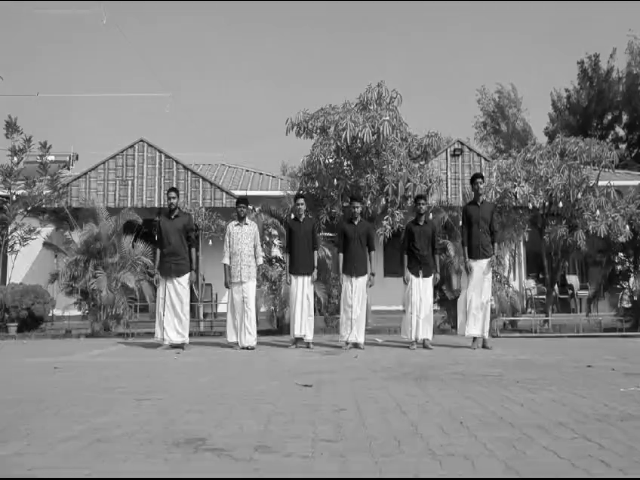

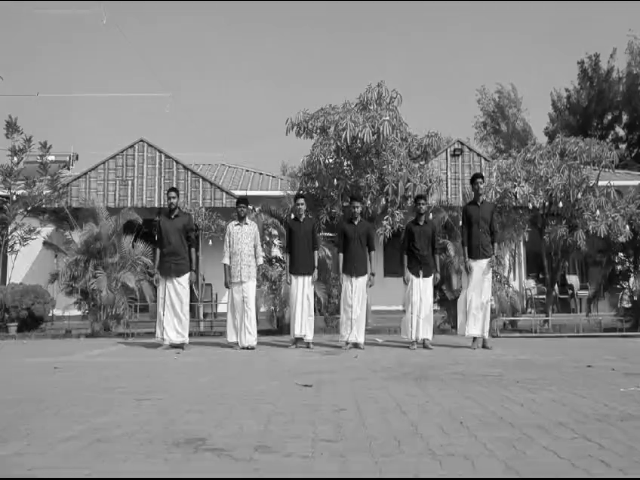

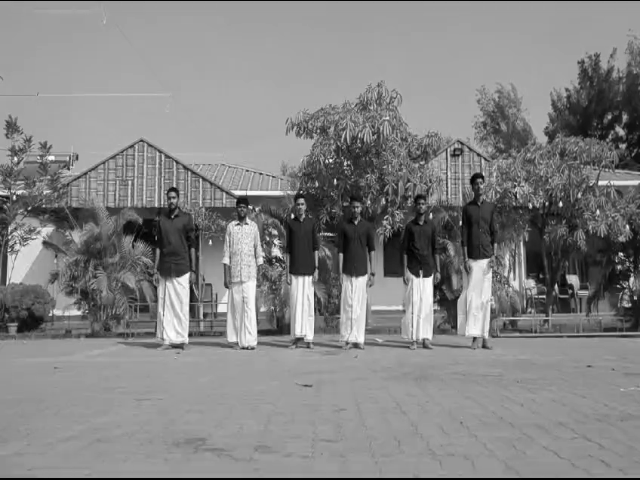

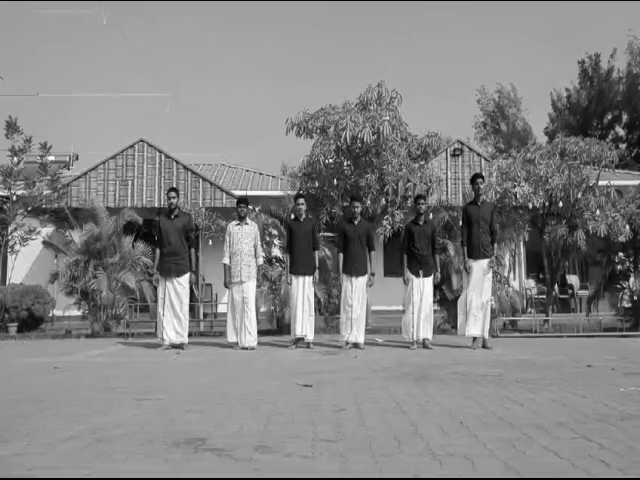

Step 3: Resized frames displayed.


In [3]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    resized_frame = cv2.resize(gray_frame, (640, 480))  # Resize to standard resolution
    cv2_imshow(resized_frame)
    frame_count += 1

cap.release()
print("Step 3: Resized frames displayed.")


Blurring the frames

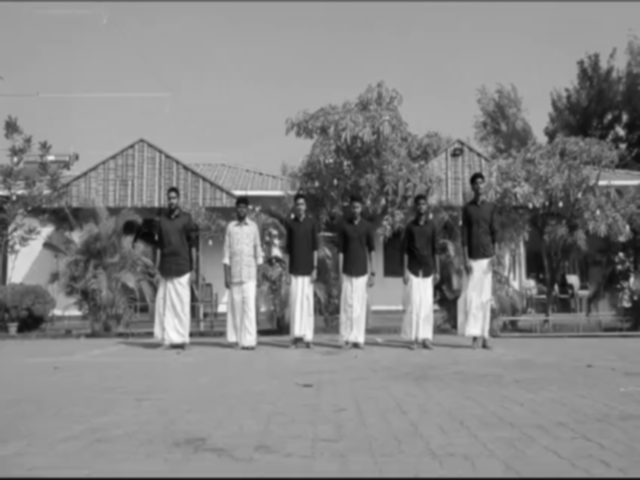

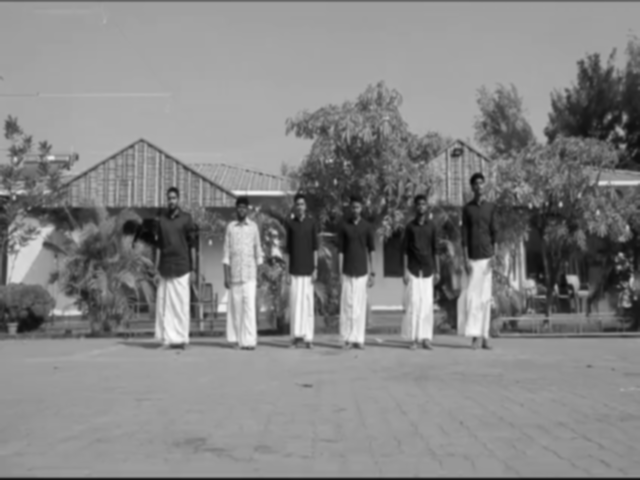

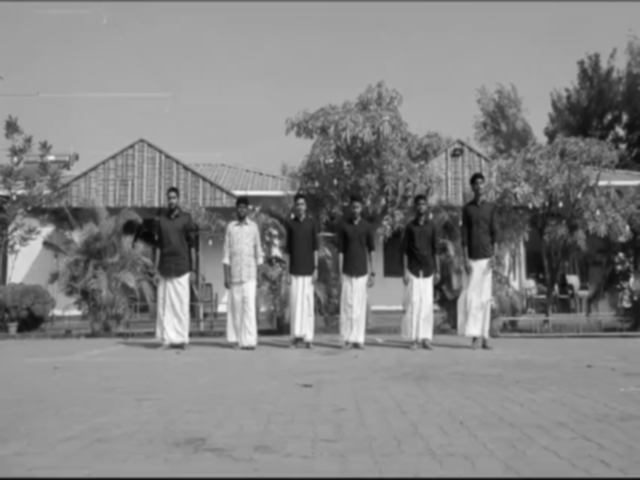

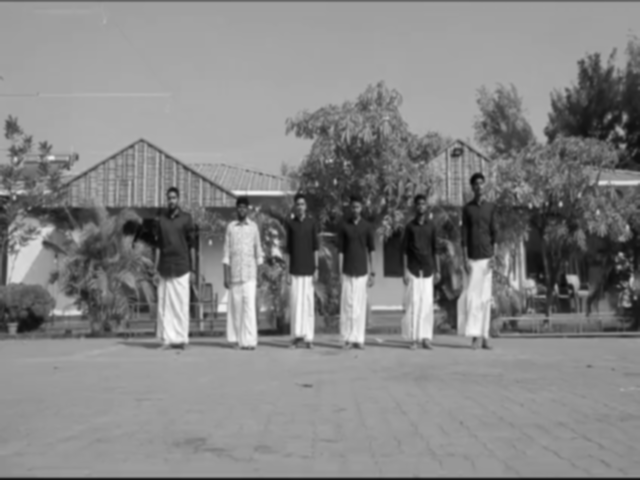

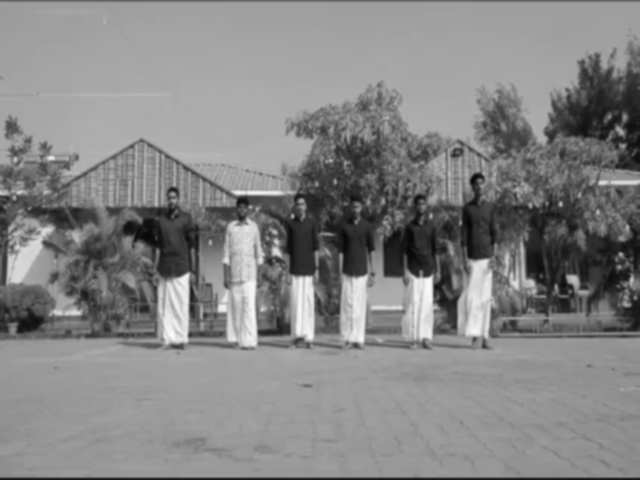

Step 4: Blurred frames displayed.


In [4]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    resized_frame = cv2.resize(gray_frame, (640, 480))
    blurred_frame = cv2.GaussianBlur(resized_frame, (5, 5), 0)  # Apply Gaussian Blur
    cv2_imshow(blurred_frame)
    frame_count += 1

cap.release()
print("Step 4: Blurred frames displayed.")


Resizing the frame

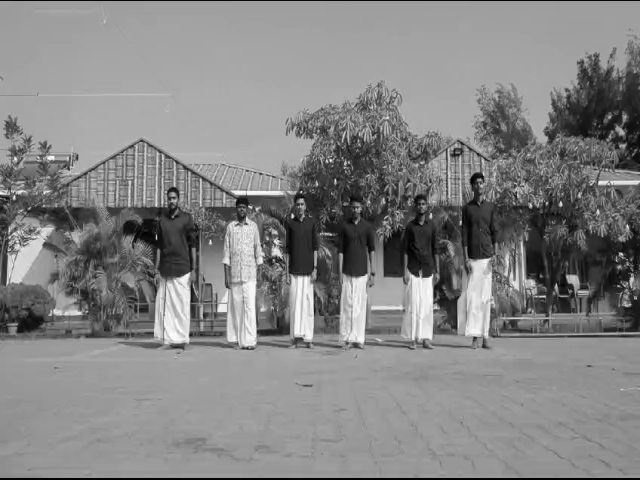

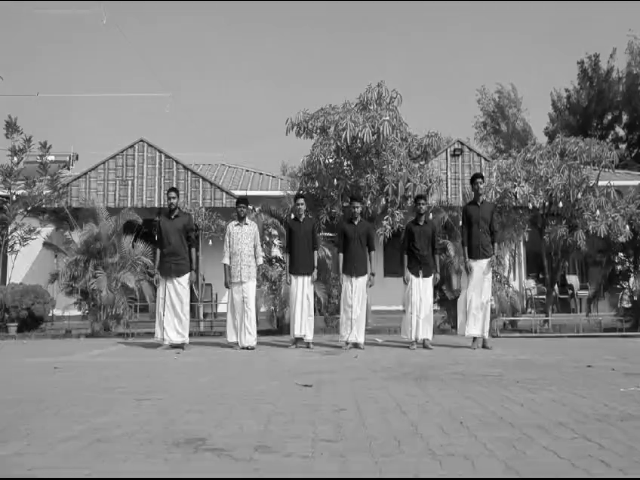

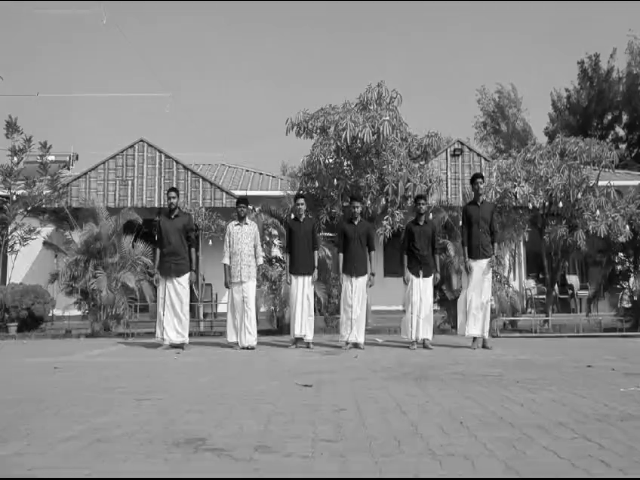

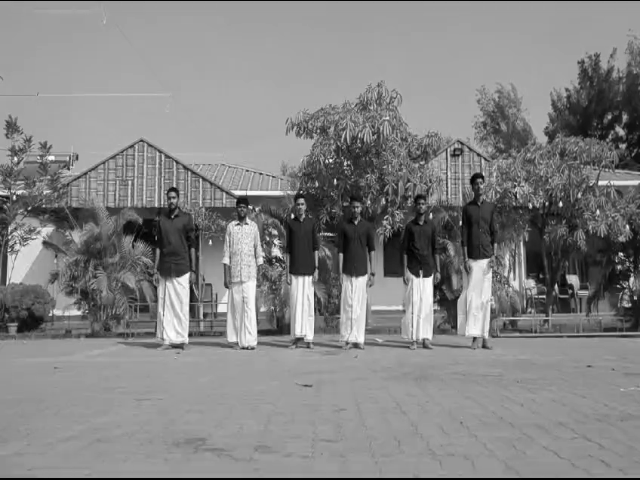

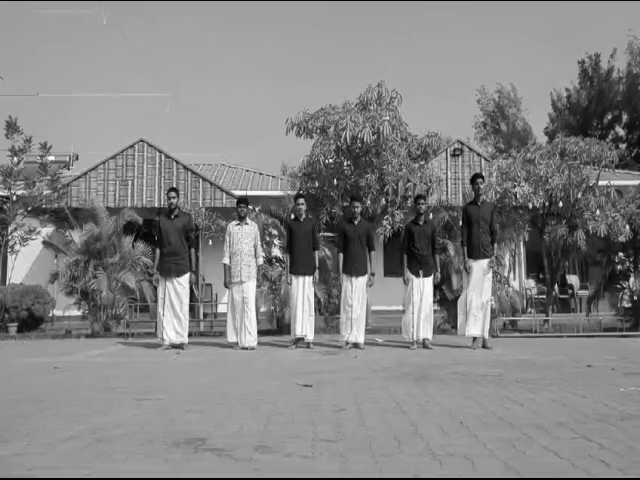

Step 3: Resized frames displayed.


In [5]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    resized_frame = cv2.resize(gray_frame, (640, 480))  # Resize to standard resolution
    cv2_imshow(resized_frame)
    frame_count += 1

cap.release()
print("Step 3: Resized frames displayed.")


Brightness & contrast adjustment

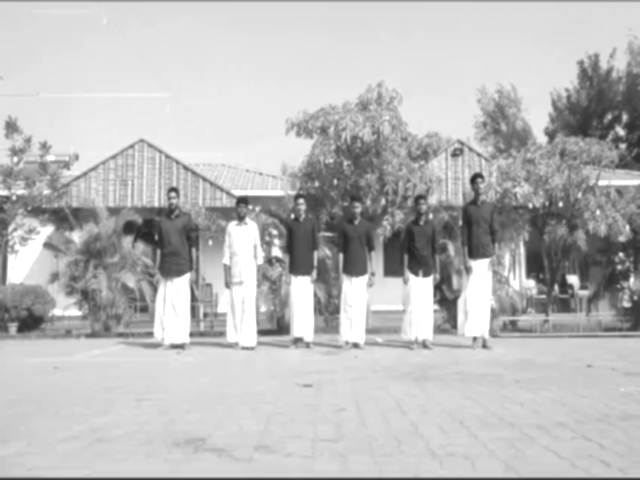

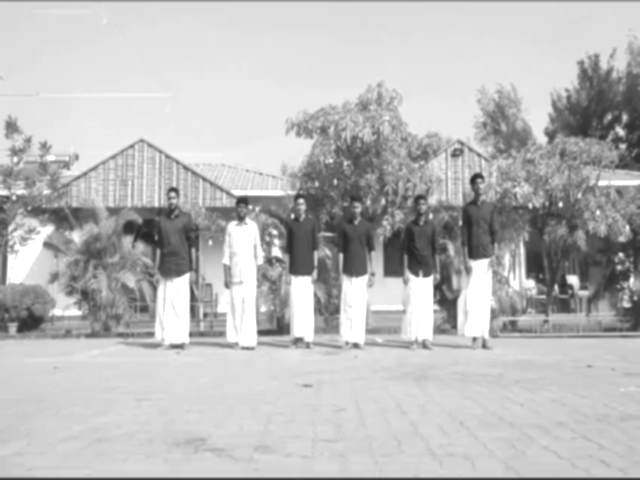

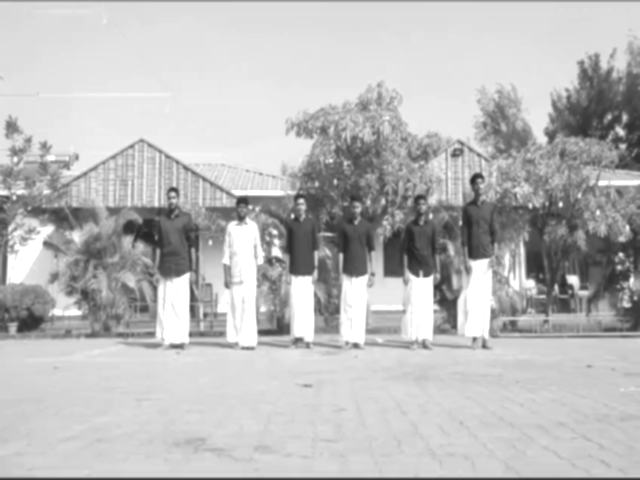

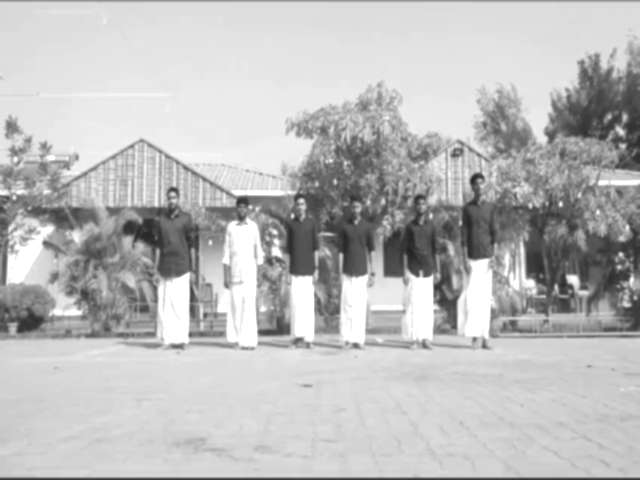

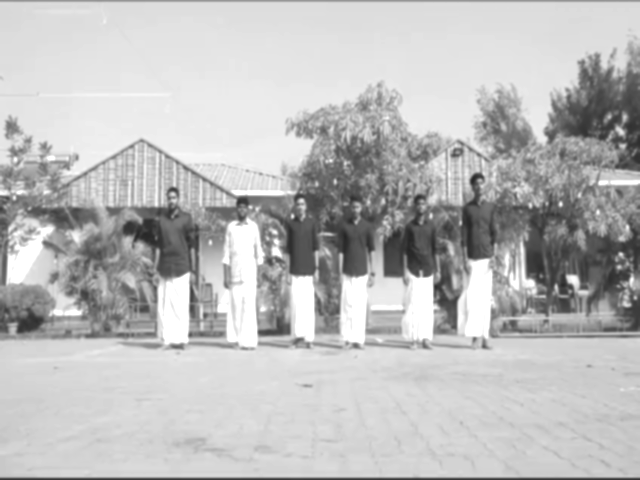

Step 5: Brightness & contrast adjusted frames displayed.


In [6]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    resized_frame = cv2.resize(gray_frame, (640, 480))
    blurred_frame = cv2.GaussianBlur(resized_frame, (5, 5), 0)
    adjusted_frame = cv2.convertScaleAbs(blurred_frame, alpha=1.2, beta=30)  # Adjust contrast & brightness
    cv2_imshow(adjusted_frame)
    frame_count += 1

cap.release()
print("Step 5: Brightness & contrast adjusted frames displayed.")


Canny  Edge-detected

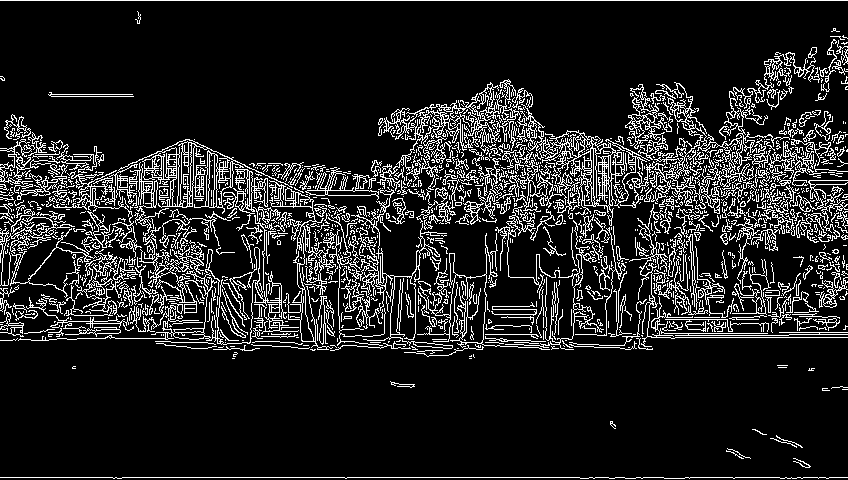

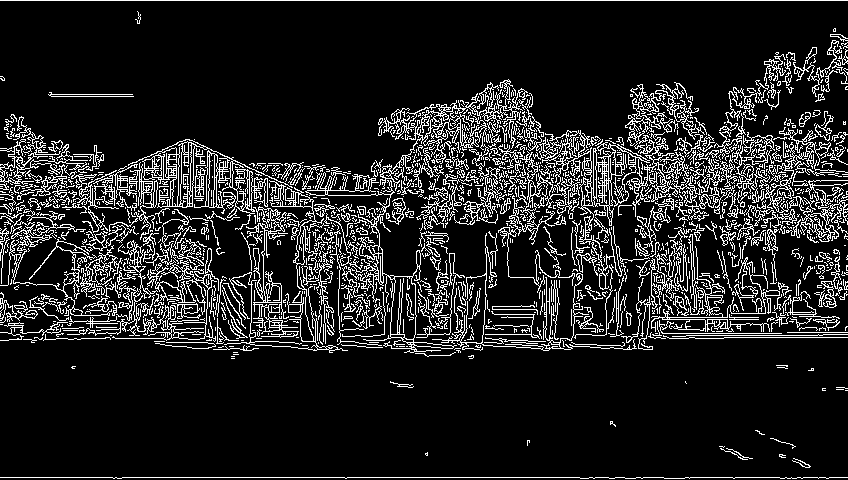

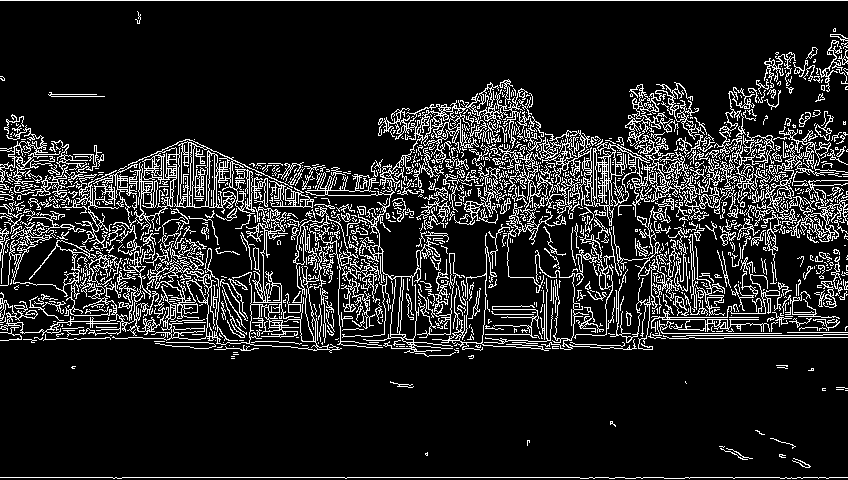

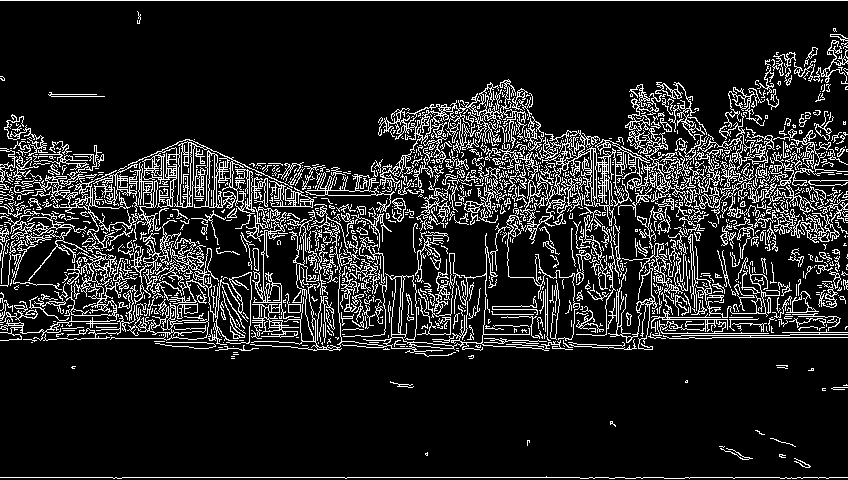

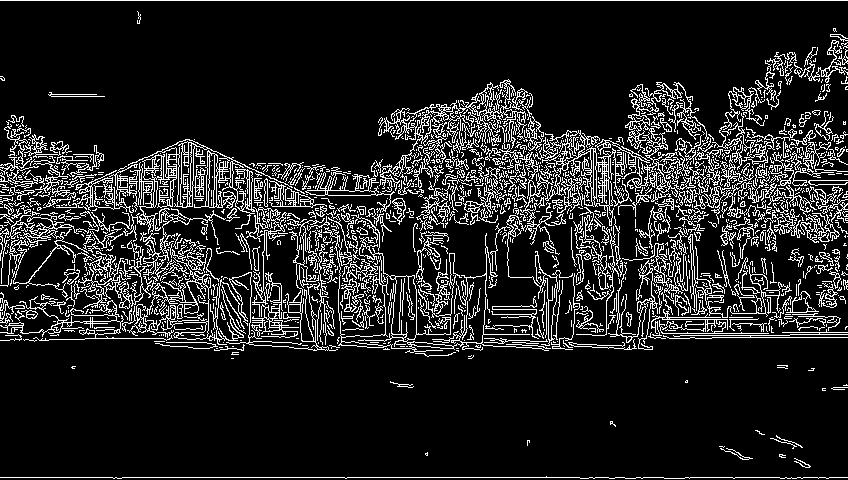

Step 6: Edge-detected frames displayed.


In [7]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray_frame, 50, 150)  # Apply Canny edge detection
    cv2_imshow(edges)
    frame_count += 1

cap.release()
print("Step 6: Edge-detected frames displayed.")


Histogram-equalized

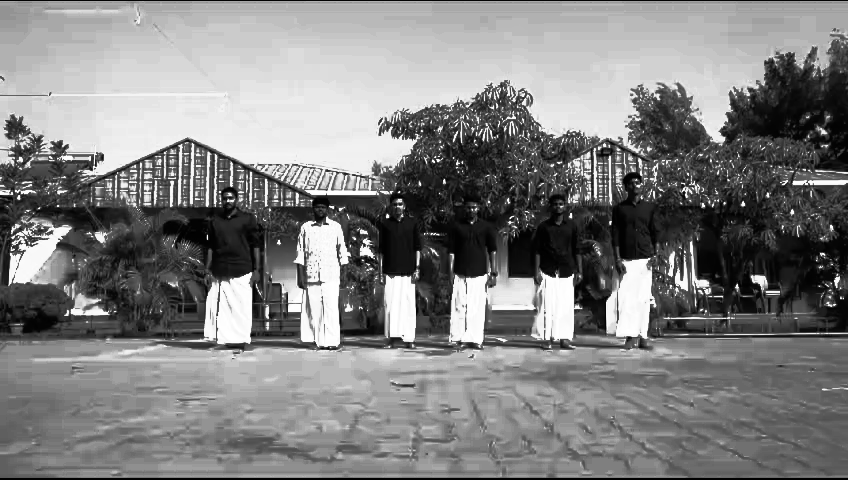

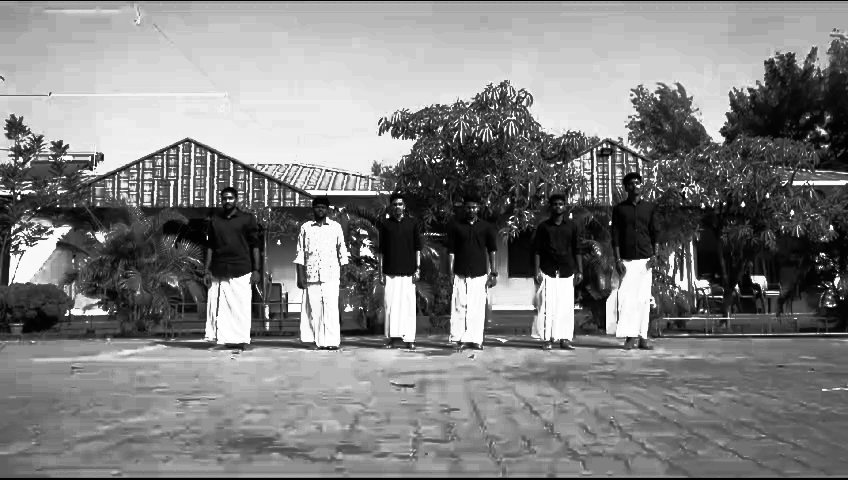

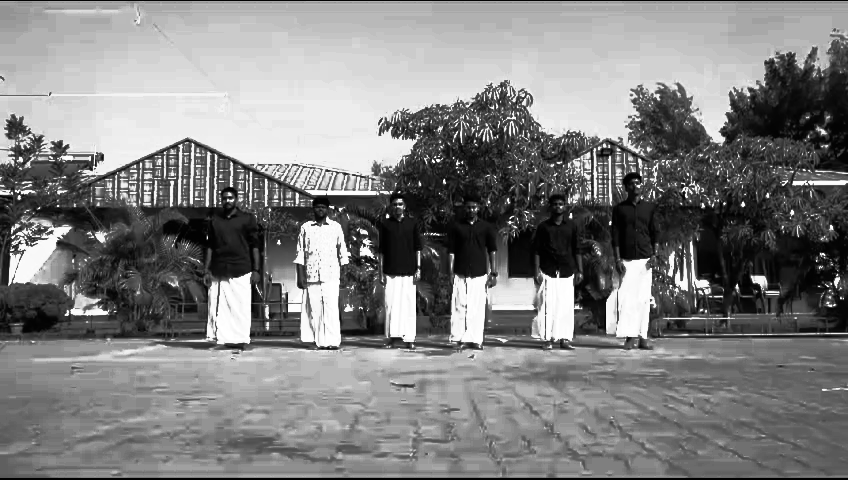

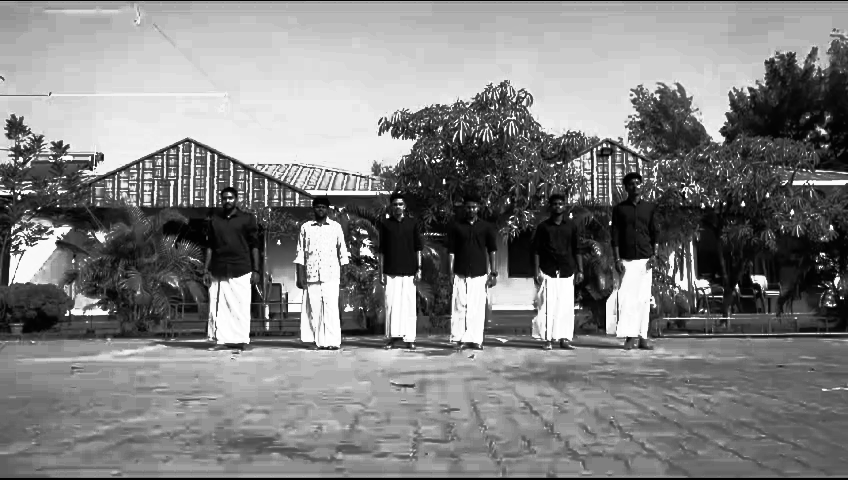

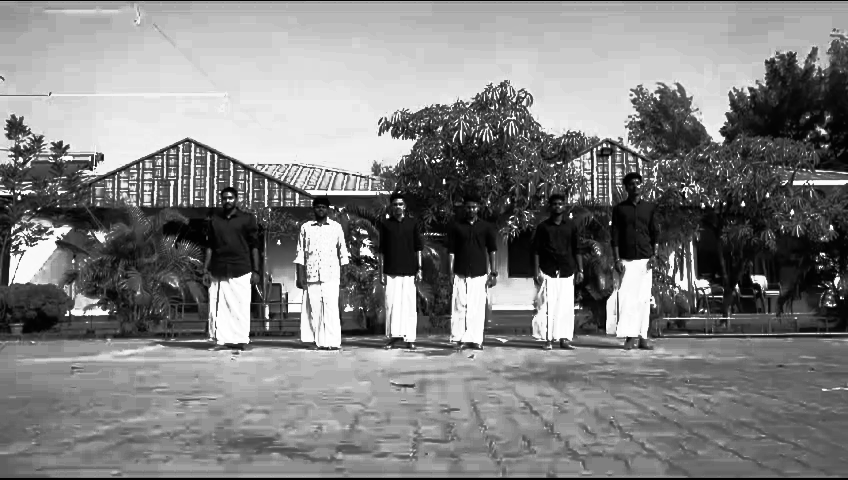

Step 7: Histogram-equalized frames displayed.


In [8]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    equalized_frame = cv2.equalizeHist(gray_frame)  # Apply histogram equalization
    cv2_imshow(equalized_frame)
    frame_count += 1

cap.release()
print("Step 7: Histogram-equalized frames displayed.")


Denoised frames

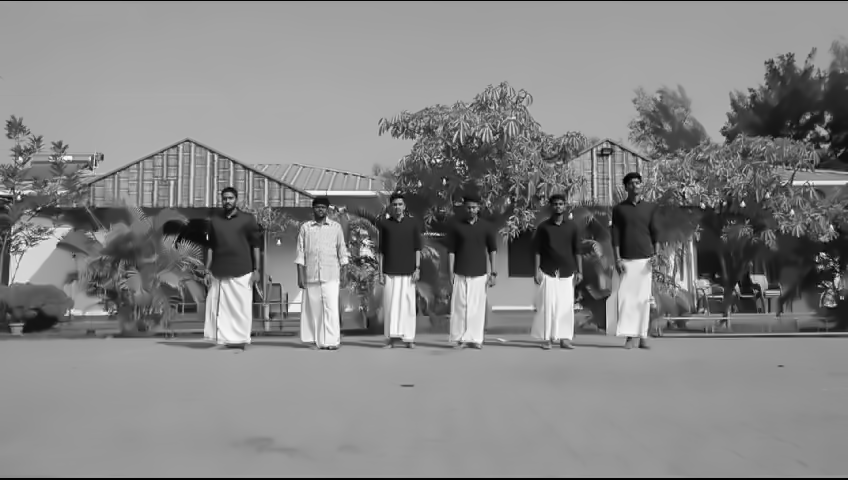

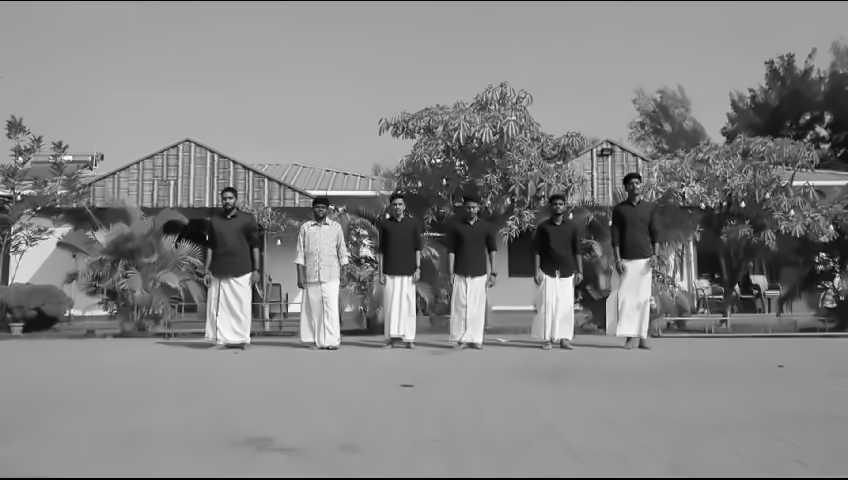

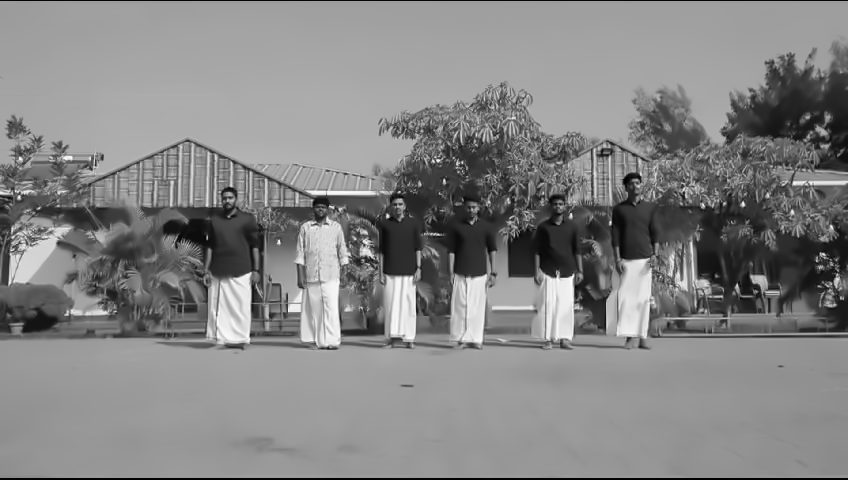

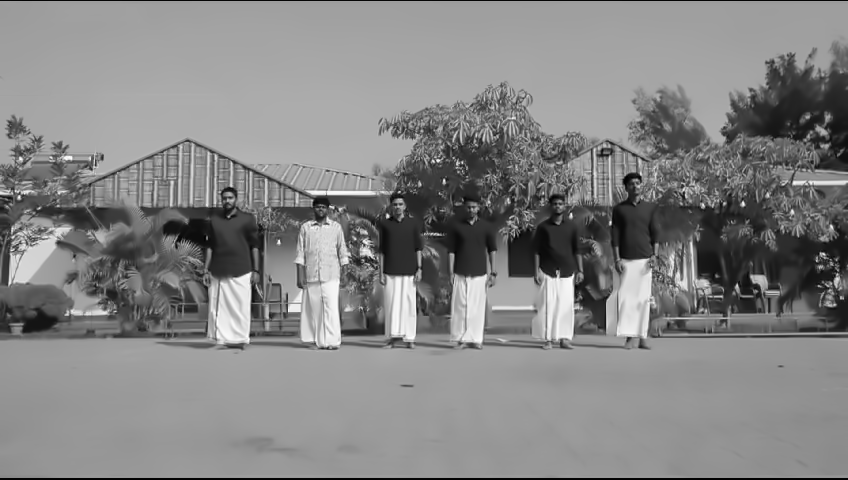

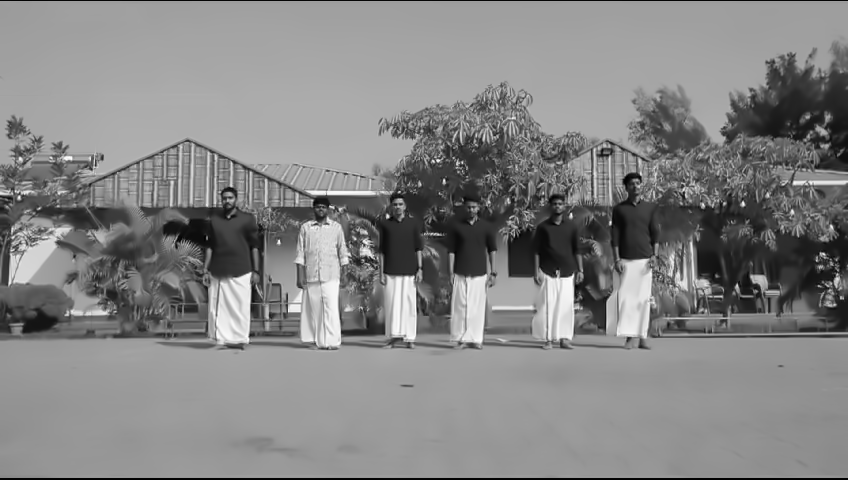

Step 8: Denoised frames displayed.


In [9]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    denoised_frame = cv2.fastNlMeansDenoising(gray_frame, None, 10, 7, 21)  # Apply denoising
    cv2_imshow(denoised_frame)
    frame_count += 1

cap.release()
print("Step 8: Denoised frames displayed.")


Thresholded frames

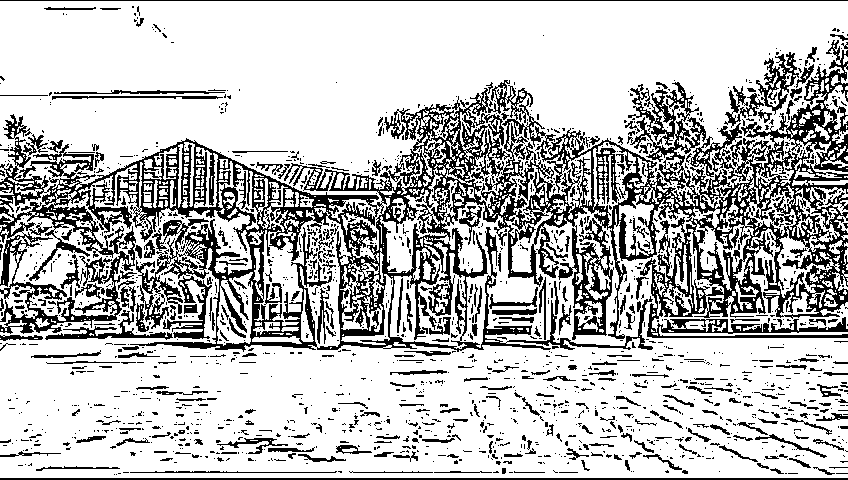

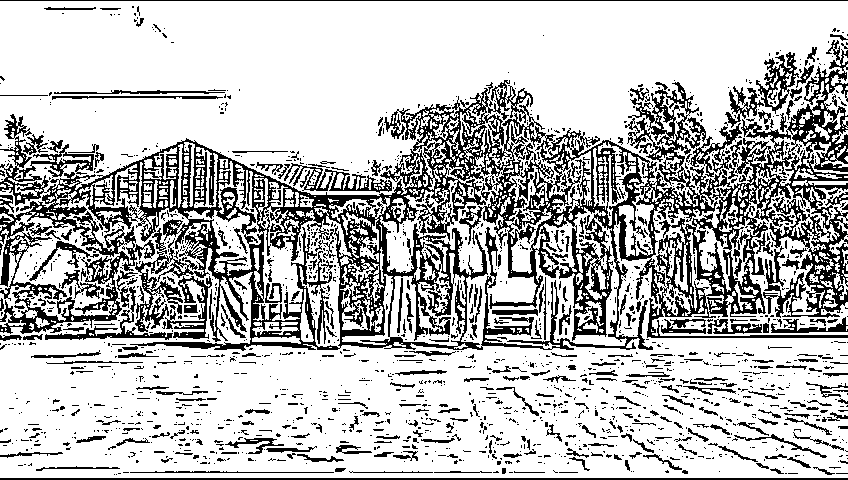

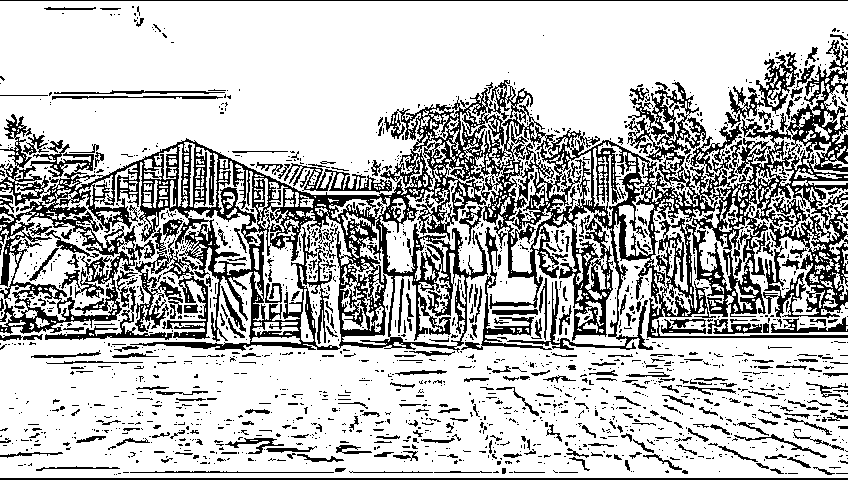

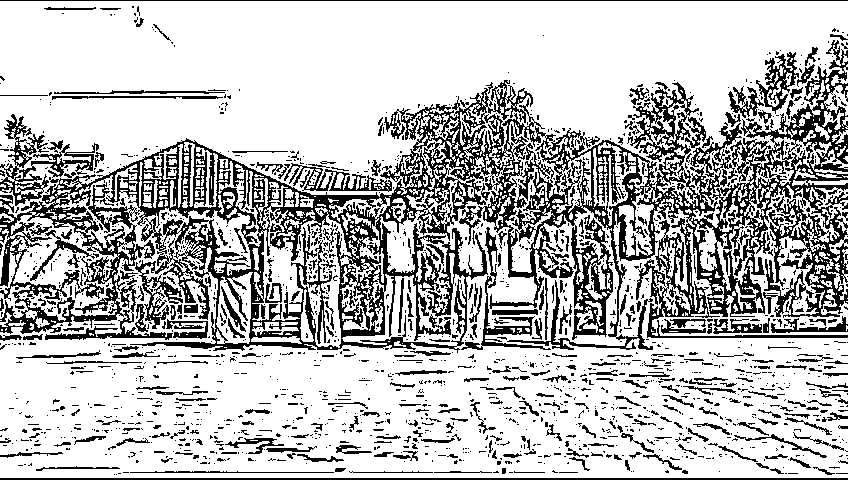

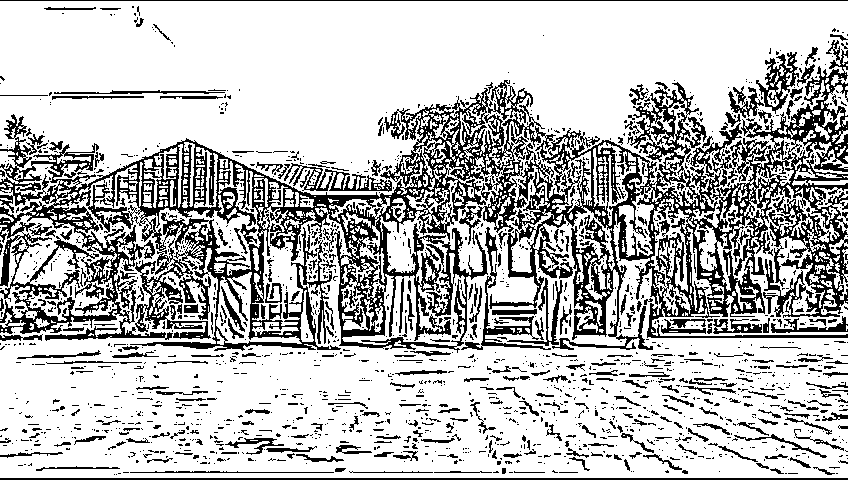

Step 9: Thresholded frames displayed.


In [10]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    threshold_frame = cv2.adaptiveThreshold(
        gray_frame, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2
    )  # Adaptive thresholding
    cv2_imshow(threshold_frame)
    frame_count += 1

cap.release()
print("Step 9: Thresholded frames displayed.")


Sobel edge-detected

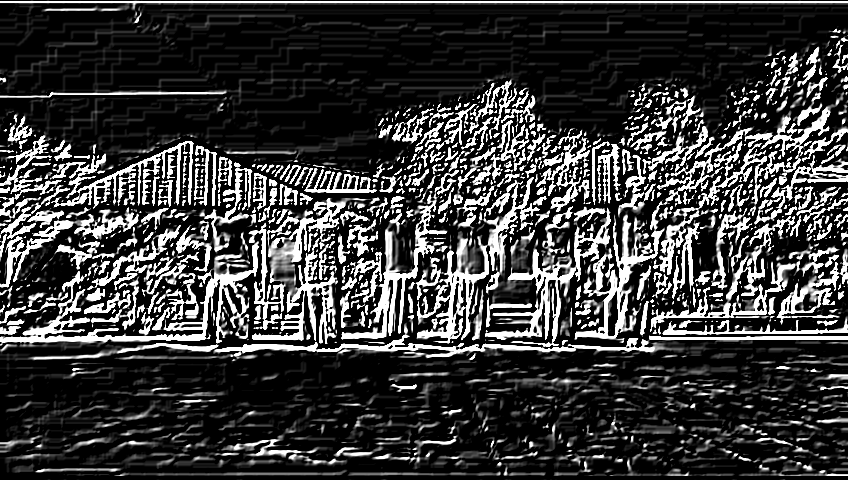

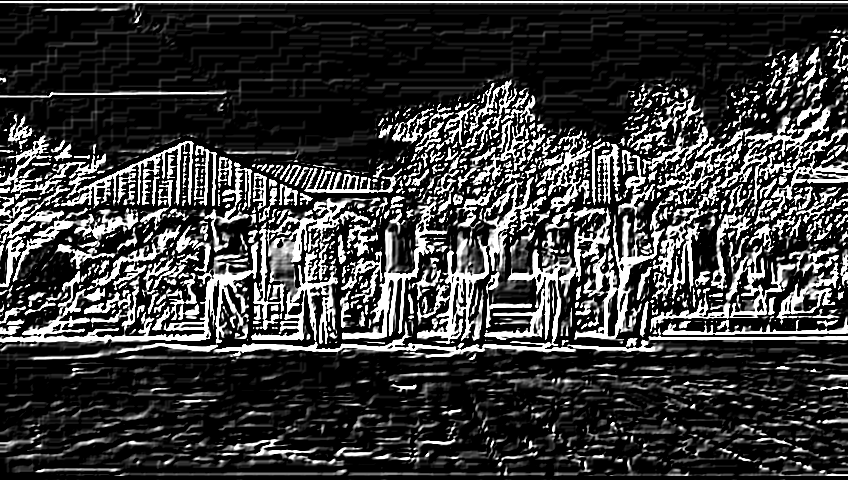

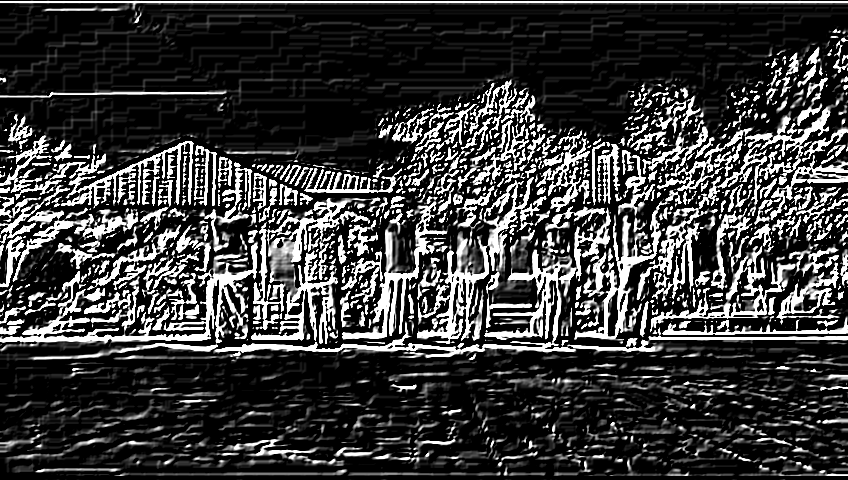

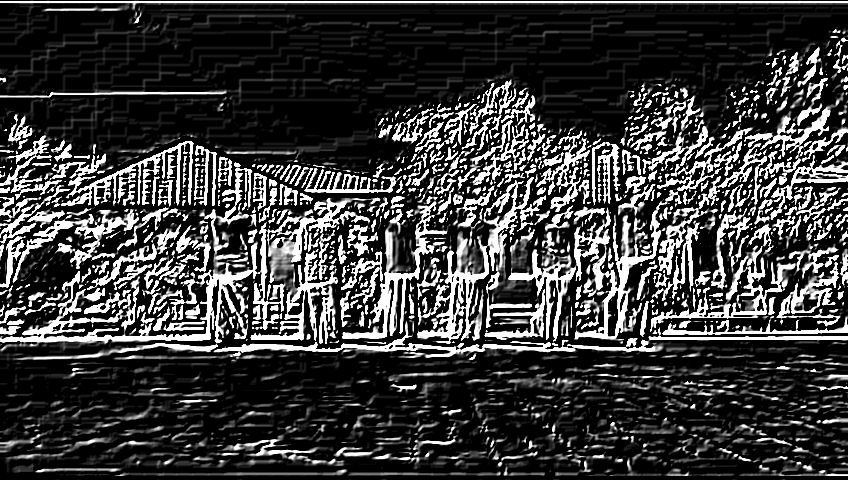

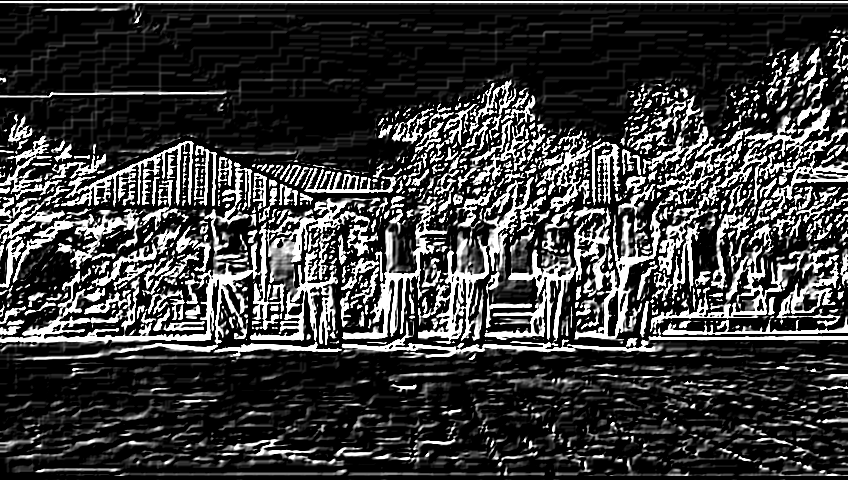

Step 10: Sobel edge-detected frames displayed.


In [11]:
cap = cv2.VideoCapture(video_path)
frame_count = 0

while frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray_frame, cv2.CV_64F, 1, 0, ksize=5)  # X-direction
    sobely = cv2.Sobel(gray_frame, cv2.CV_64F, 0, 1, ksize=5)  # Y-direction
    sobel_combined = cv2.addWeighted(sobelx, 0.5, sobely, 0.5, 0)  # Combine both
    cv2_imshow(sobel_combined)
    frame_count += 1

cap.release()
print("Step 10: Sobel edge-detected frames displayed.")


In [12]:
import cv2
import os
import json
from google.colab.patches import cv2_imshow

# Define paths
video_path = "/content/videostg.mp4"
output_dir = "preprocessed_frames"
metadata_file = "frame_metadata.json"

# Create directory if it doesn't exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Open the video file
cap = cv2.VideoCapture(video_path)

# Check if video is opened successfully
if not cap.isOpened():
    print("Error: Could not open video file.")
    exit()
else:
    print("Processing video...")

frame_count = 0
frame_data = {}

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Convert to grayscale
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Resize frame
    resized_frame = cv2.resize(gray_frame, (640, 480))

    # Apply Gaussian Blur
    blurred_frame = cv2.GaussianBlur(resized_frame, (5, 5), 0)

    # Adjust brightness & contrast
    adjusted_frame = cv2.convertScaleAbs(blurred_frame, alpha=1.2, beta=30)

    # Apply Edge Detection (Canny)
    edges = cv2.Canny(adjusted_frame, 50, 150)

    # Save the final preprocessed frame
    frame_filename = os.path.join(output_dir, f"frame_{frame_count:04d}.png")
    cv2.imwrite(frame_filename, edges)

    # Store metadata
    frame_data[frame_filename] = {
        "frame_number": frame_count,
        "size": (640, 480),
        "preprocessing_steps": ["grayscale", "resize", "gaussian_blur", "contrast_adjustment", "edge_detection"]
    }

    frame_count += 1

# Save metadata as JSON
with open(metadata_file, "w") as f:
    json.dump(frame_data, f, indent=4)

# Release video capture
cap.release()

# Print results
print(f"Preprocessing complete. {frame_count} frames saved in '{output_dir}'")
print(f"Metadata saved in '{metadata_file}'")


Processing video...
Preprocessing complete. 316 frames saved in 'preprocessed_frames'
Metadata saved in 'frame_metadata.json'


In [13]:
!pip install pycryptodome


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 58.7 MB/s eta 0:00:00


Converting the Secret Message into HExadecimal and AES Encrypted Value

In [14]:
from Crypto.Cipher import AES
import binascii
import os
import json

# Function to pad the message to be a multiple of AES block size (16 bytes)
def pad_message(message):
    block_size = AES.block_size  # AES block size is 16 bytes
    padding_length = block_size - len(message) % block_size
    padding = chr(padding_length) * padding_length
    return message + padding

# Function to encrypt a message using AES encryption
def encrypt_message(secret_message):
    key = os.urandom(32)  # Generate a random 256-bit AES key
    cipher = AES.new(key, AES.MODE_ECB)  # Create AES cipher in ECB mode

    # Convert message to hexadecimal format
    hex_message = binascii.hexlify(secret_message.encode()).decode()

    # Pad and encrypt the message
    padded_message = pad_message(hex_message)
    encrypted_bytes = cipher.encrypt(padded_message.encode())

    # Convert encrypted bytes to hexadecimal
    encrypted_hex = binascii.hexlify(encrypted_bytes).decode()

    return hex_message, encrypted_hex, key.hex()  # Return hex message, encrypted hex, and key

# 🔹 Example usage: User provides the secret message
secret_message = input("Enter the secret message: ")  # User input

hex_message, encrypted_hex, encryption_key = encrypt_message(secret_message)

# Save encryption details in a JSON file
encryption_data = {
    "original_message": secret_message,
    "hexadecimal_message": hex_message,
    "encrypted_message": encrypted_hex,
    "encryption_key": encryption_key
}

with open("encryption_data.json", "w") as f:
    json.dump(encryption_data, f, indent=4)

# Print results
print("\n🔹 Original Message:", secret_message)
print("🔹 Hexadecimal Message:", hex_message)
print("🔹 Encrypted Message (AES Hex):", encrypted_hex)
print("🔹 Encryption Key (256-bit):", encryption_key)
print("\n✅ Encryption data saved to 'encryption_data.json'")


Enter the secret message: so presenting you the my team first of all my name is natraj and tese are my teammembers chiranjeevi with his number 22036 and another one name is vutla varun with his number 22046 and now we are going to explain about the topic image and video steganograph

🔹 Original Message: so presenting you the my team first of all my name is natraj and tese are my teammembers chiranjeevi with his number 22036 and another one name is vutla varun with his number 22046 and now we are going to explain about the topic image and video steganograph
🔹 Hexadecimal Message: 736f2070726573656e74696e6720796f7520746865206d79207465616d206669727374206f6620616c6c206d79206e616d65206973206e617472616a20616e64207465736520617265206d79207465616d6d656d626572732063686972616e6a65657669207769746820686973206e756d62657220323230333620616e6420616e6f74686572206f6e65206e616d65206973207675746c6120766172756e207769746820686973206e756d62657220323230343620616e64206e6f772077652061726520676f696e6720746f206578

In [15]:
!pip install opencv-python numpy scipy scikit-image


Steganography using LSB Method

In [16]:
import cv2
import numpy as np
import binascii
import json
import os
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Load the encrypted message from JSON file
with open("encryption_data.json", "r") as f:
    encryption_data = json.load(f)

encrypted_message = encryption_data["encrypted_message"]  # Hexadecimal encrypted message
message_bits = ''.join(format(int(char, 16), '04b') for char in encrypted_message)  # Convert hex to binary

# Directory containing preprocessed frames
preprocessed_frames_dir = "preprocessed_frames"

# List all frames and pick the first available frame
frame_files = sorted([f for f in os.listdir(preprocessed_frames_dir) if f.endswith(".png")])

if not frame_files:
    print("Error: No frames found in 'preprocessed_frames'!")
    exit()

# Select the first frame for hiding the message
selected_frame_filename = frame_files[0]  # Pick the first frame
frame_number = int(selected_frame_filename.split("_")[1].split(".")[0])  # Extract frame number

frame_path = os.path.join(preprocessed_frames_dir, selected_frame_filename)

# Load the selected frame
frame = cv2.imread(frame_path, cv2.IMREAD_GRAYSCALE)  # Read frame in grayscale
if frame is None:
    print(f"Error: Could not load the frame '{frame_path}'.")
    exit()

# Get frame dimensions
height, width = frame.shape

# Get original frame size before modification
original_size = os.path.getsize(frame_path)

# Ensure message fits in the frame
max_bits = height * width  # Max bits we can hide (1 bit per pixel)
if len(message_bits) > max_bits:
    print("Error: Encrypted message is too large to fit in one frame!")
    exit()

# Copy original frame for modification
stego_frame = np.copy(frame)

# Embed message using LSB
bit_index = 0
for row in range(height):
    for col in range(width):
        if bit_index < len(message_bits):
            pixel_value = stego_frame[row, col]
            pixel_value = (pixel_value & 0xFE) | int(message_bits[bit_index])  # Modify LSB
            stego_frame[row, col] = pixel_value
            bit_index += 1
        else:
            break
    if bit_index >= len(message_bits):
        break

# Compute PSNR and SSIM between original and modified frames
psnr_value = psnr(frame, stego_frame)
ssim_value = ssim(frame, stego_frame, data_range=stego_frame.max() - stego_frame.min())

# Save the stego frame in the same directory
stego_frame_path = os.path.join(preprocessed_frames_dir, f"stego_{selected_frame_filename}")
cv2.imwrite(stego_frame_path, stego_frame)

# Get modified frame size after hiding data
modified_size = os.path.getsize(stego_frame_path)

# Print results
print(f"\n🔹 Encrypted message hidden in frame {frame_number}")
print(f"🔹 Original frame size: {original_size} bytes")
print(f"🔹 Modified frame size: {modified_size} bytes")
print("🔹 PSNR (Peak Signal-to-Noise Ratio):", psnr_value)
print("🔹 SSIM (Structural Similarity Index):", ssim_value)
print(f"✅ Stego frame saved as '{stego_frame_path}'")



🔹 Encrypted message hidden in frame 0
🔹 Original frame size: 23944 bytes
🔹 Modified frame size: 24949 bytes
🔹 PSNR (Peak Signal-to-Noise Ratio): 69.85581516234964
🔹 SSIM (Structural Similarity Index): 0.9999027967774011
✅ Stego frame saved as 'preprocessed_frames/stego_frame_0000.png'


Reconstructing the Video

In [17]:
import cv2
import os

# Define the directory containing frames
preprocessed_frames_dir = "preprocessed_frames"
output_video_path = "reconstructed_video.avi"

# Get the list of frames (original + stego)
frame_files = sorted([f for f in os.listdir(preprocessed_frames_dir) if f.endswith(".png")])

if not frame_files:
    print("Error: No frames found in 'preprocessed_frames'!")
    exit()

# Read the first frame to get video properties
first_frame_path = os.path.join(preprocessed_frames_dir, frame_files[0])
first_frame = cv2.imread(first_frame_path)

if first_frame is None:
    print("Error: Could not load the first frame!")
    exit()

# Get frame dimensions
height, width, layers = first_frame.shape

# Define the video writer
fourcc = cv2.VideoWriter_fourcc(*'XVID')  # Codec for AVI format
fps = 30  # You can adjust FPS
video_writer = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

# Process and write each frame
for frame_file in frame_files:
    frame_path = os.path.join(preprocessed_frames_dir, frame_file)

    # Load the frame
    frame = cv2.imread(frame_path)
    if frame is None:
        print(f"Warning: Could not load frame '{frame_file}', skipping.")
        continue

    # Write frame to video
    video_writer.write(frame)
    print(f"✅ Added frame {frame_file} to video.")

# Release the video writer
video_writer.release()
print(f"\n🎥 Video reconstruction complete! Video saved as '{output_video_path}'")


✅ Added frame frame_0000.png to video.
✅ Added frame frame_0001.png to video.
✅ Added frame frame_0002.png to video.
✅ Added frame frame_0003.png to video.
✅ Added frame frame_0004.png to video.
✅ Added frame frame_0005.png to video.
✅ Added frame frame_0006.png to video.
✅ Added frame frame_0007.png to video.
✅ Added frame frame_0008.png to video.
✅ Added frame frame_0009.png to video.
✅ Added frame frame_0010.png to video.
✅ Added frame frame_0011.png to video.
✅ Added frame frame_0012.png to video.
✅ Added frame frame_0013.png to video.
✅ Added frame frame_0014.png to video.
✅ Added frame frame_0015.png to video.
✅ Added frame frame_0016.png to video.
✅ Added frame frame_0017.png to video.
✅ Added frame frame_0018.png to video.
✅ Added frame frame_0019.png to video.
✅ Added frame frame_0020.png to video.
✅ Added frame frame_0021.png to video.
✅ Added frame frame_0022.png to video.
✅ Added frame frame_0023.png to video.
✅ Added frame frame_0024.png to video.
✅ Added frame frame_0025.

Extracting the AES Encrypted Hexadecimal Value form the Frame

In [18]:
import cv2
import numpy as np
from Crypto.Cipher import AES
import binascii


def hide_message_in_frame(frame_path, message, output_path):
    frame = cv2.imread(frame_path)
    if frame is None:
        raise ValueError("Could not load the input image.")
    binary_message = ''.join(format(ord(char), '08b') for char in message)
    data_index = 0
    for row in frame:
        for pixel in row:
            for channel in range(3):
                if data_index < len(binary_message):
                    # Clear LSB and set it to the binary message bit
                    pixel[channel] = (pixel[channel] & 0xFE) | int(binary_message[data_index])
                    data_index += 1
                if data_index >= len(binary_message):
                    break
            if data_index >= len(binary_message):
                break
        if data_index >= len(binary_message):
            break
    cv2.imwrite(output_path, frame)

def extract_message_from_frame(stego_frame_path, message_length):
    frame = cv2.imread(stego_frame_path)
    if frame is None:
        raise ValueError("Could not load the stego image.")
    binary_message = ""
    for row in frame:
        for pixel in row:
            for channel in range(3):
                binary_message += str(pixel[channel] & 1)
                if len(binary_message) >= message_length * 8:
                    break
            if len(binary_message) >= message_length * 8:
                break
        if len(binary_message) >= message_length * 8:
            break
    hex_message = ""
    for i in range(0, len(binary_message), 8):
        byte = binary_message[i:i+8]
        if len(byte) == 8:
            char_val = int(byte, 2)
            hex_char = chr(char_val)
            if hex_char in '0123456789abcdefABCDEF':
                hex_message += hex_char
            else:
                print(f"Warning: Invalid hex character '{hex_char}' at position {i//8}")
    return hex_message

def main():
    key_hex = 'f3d7fbb0e5b9cc09dffad3621598bf3983151932e4ddfaa18ae68a77fe0dd2e0'
    key = binascii.unhexlify(key_hex)
    original_frame_path = "/content/preprocessed_frames/frame_0000.png"
    stego_frame_path = "/content/preprocessed_frames/stego_frame_0000.png"

    # Re-embed the message
    message = "so presenting you the my team first of all my name is natraj and tese are my teammembers chiranjeevi with his number 22036 and another one name is vutla varun with his number 22046 and now we are going to explain about the topic image and video steganograph"
    hide_message_in_frame(original_frame_path, encrypted_message, stego_frame_path)
    print("Message hidden in frame.")

    # Extract and decrypt
    encrypted_message_length = len(encrypted_message)
    extracted_encrypted_message = extract_message_from_frame(stego_frame_path, encrypted_message_length)
    print("Extracted Encrypted Message:", extracted_encrypted_message)


if __name__ == "__main__":
    main()

Message hidden in frame.
Extracted Encrypted Message: 5741b73e8d8e5aa9913eb65554b0081c4fd16ae682f7b1e648c77b3963ccd8dcb739380c0a0844ea6b048dfa6c9f59d94cf4643fe5f61ee62876f4409886289c658194c142a2c6da83a3ed37eaaf414ead3e1f16300ec29d4e09b70b75146258d0764857feed20851714deb6e9b6aa6752c9497bccd4dac51f48fe74f83ed2ac9570819b2a9a9d617fe33a430c3c50cd8bd81110a8b4695eba6339e8d3e9cb5a69975ea6d40ccd97a0559cd82e1f436bd24125d7cd5ca158720a620ded022d012b020667822fdce5ab7d117535e42cce63771d6fb2d9f199492c88106874fa9f1c56358a97eb30e014890cfd2cd4d643034694954e263d14454d5d8f6cdaaee5b68d124024d68230e0c9718fb7c7408646444fae82cec93edcca27a7e9c328ddf681f61e3dd5a1b785056320521dd4a8c65c781fbc0d32f02fbe6cc7f414be4fbd048b430abf50940d444c5b26936402ee7d0ec3bcc3945f50777602763838ebb317c20481cd76079ce2a2ecbba1460f1e896d62579541106fc435a874b59f5894fb6c1e3e1e7e32a3daac1e7b7e2af6146d0d91c5ee97535c94579681026505784b411a3cfd53f1d886f77a8be17900495ce18055b18c5a87a7ade49c02a9339cd8639b11f47a1c521389e04c2ae82689eddf692476c663c6

Converting extracted  AES Encrytped value into the hexadecimal values

In [20]:
import binascii
from Crypto.Cipher import AES

def decrypt_message(encrypted_hex, key):
    try:
        # Convert hex string to bytes
        encrypted_bytes = binascii.unhexlify(encrypted_hex)

        # Create AES cipher in ECB mode with the provided key
        cipher = AES.new(key, AES.MODE_ECB)

        # Decrypt the message
        decrypted_bytes = cipher.decrypt(encrypted_bytes)

        # Decode the decrypted bytes to UTF-8, removing trailing padding
        decrypted_message = decrypted_bytes.decode('utf-8').rstrip()

        return decrypted_message
    except Exception as e:
        return f"Decryption error: {str(e)}"

def main():
    # Fixed key (32 bytes for AES-256)
    key_hex = '13a313c5a3c4f11eeb77d80dab7cbd979877da933e1713186bdb8a98fd3cc5de'
    key = binascii.unhexlify(key_hex)

    # Encrypted hexadecimal value
    encrypted_hex = "5741b73e8d8e5aa9913eb65554b0081c4fd16ae682f7b1e648c77b3963ccd8dcb739380c0a0844ea6b048dfa6c9f59d94cf4643fe5f61ee62876f4409886289c658194c142a2c6da83a3ed37eaaf414ead3e1f16300ec29d4e09b70b75146258d0764857feed20851714deb6e9b6aa6752c9497bccd4dac51f48fe74f83ed2ac9570819b2a9a9d617fe33a430c3c50cd8bd81110a8b4695eba6339e8d3e9cb5a69975ea6d40ccd97a0559cd82e1f436bd24125d7cd5ca158720a620ded022d012b020667822fdce5ab7d117535e42cce63771d6fb2d9f199492c88106874fa9f1c56358a97eb30e014890cfd2cd4d643034694954e263d14454d5d8f6cdaaee5b68d124024d68230e0c9718fb7c7408646444fae82cec93edcca27a7e9c328ddf681f61e3dd5a1b785056320521dd4a8c65c781fbc0d32f02fbe6cc7f414be4fbd048b430abf50940d444c5b26936402ee7d0ec3bcc3945f50777602763838ebb317c20481cd76079ce2a2ecbba1460f1e896d62579541106fc435a874b59f5894fb6c1e3e1e7e32a3daac1e7b7e2af6146d0d91c5ee97535c94579681026505784b411a3cfd53f1d886f77a8be17900495ce18055b18c5a87a7ade49c02a9339cd8639b11f47a1c521389e04c2ae82689eddf692476c663c6d3e3964bf365851f61d60d075cbc258c0c0bd015d9fce8b94ebc283e488e76368536923316fc5a1c3ca28dec477cee40eb1a512aefd672"

    # Decrypt and print the message
    decrypted_message = decrypt_message(encrypted_hex, key)
    print("Decrypted Message:", decrypted_message)

if __name__ == "__main__":
    main()

Decrypted Message: 736f2070726573656e74696e6720796f7520746865206d79207465616d206669727374206f6620616c6c206d79206e616d65206973206e617472616a20616e64207465736520617265206d79207465616d6d656d626572732063686972616e6a65657669207769746820686973206e756d62657220323230333620616e6420616e6f74686572206f6e65206e616d65206973207675746c6120766172756e207769746820686973206e756d62657220323230343620616e64206e6f772077652061726520676f696e6720746f206578706c61696e2061626f75742074686520746f70696320696d61676520616e6420766964656f2073746567616e6f6772617068


Converting the Hexadecimal value into the Original Secret Text

In [21]:
import binascii

def hex_to_text(hex_message):
    try:
        # Convert hex string to bytes
        message_bytes = binascii.unhexlify(hex_message)

        # Decode bytes to UTF-8 text
        text_message = message_bytes.decode('utf-8')

        return text_message
    except Exception as e:
        return f"Conversion error: {str(e)}"

def main():
    # Your hexadecimal message
    hex_message = "736f2070726573656e74696e6720796f7520746865206d79207465616d206669727374206f6620616c6c206d79206e616d65206973206e617472616a20616e64207465736520617265206d79207465616d6d656d626572732063686972616e6a65657669207769746820686973206e756d62657220323230333620616e6420616e6f74686572206f6e65206e616d65206973207675746c6120766172756e207769746820686973206e756d62657220323230343620616e64206e6f772077652061726520676f696e6720746f206578706c61696e2061626f75742074686520746f70696320696d61676520616e6420766964656f2073746567616e6f6772617068"

    # Convert and print the original message
    original_message = hex_to_text(hex_message)
    print("Original Secret Message:", original_message)

if __name__ == "__main__":
    main()

Original Secret Message: so presenting you the my team first of all my name is natraj and tese are my teammembers chiranjeevi with his number 22036 and another one name is vutla varun with his number 22046 and now we are going to explain about the topic image and video steganograph
